# Привет! :)

<div class="alert alert-block alert-info"><b><a href="https://disk.yandex.ru/i/65tOz_-Cw9jFRQ">Ссылка</a> на презентацию</b>.

# Исследование рынка общественного питания в г. Москве

# Цель проекта

Изучить рынок и его особенности, чтобы в дальнейшем можно было принять решение об отрытии заведения (его тип, место, ценник). 

Для анализа предоставлены данные рынка г. Москвы по состоянию на лето 2022 года. 

# Описание данных

Для изучения предоставлен файл `moscow_places.csv`, содержащий следующую информацию.

- `name` — название заведения;

- `address` — адрес заведения;

- `category` — категория заведения, например «кафе», «пиццерия» или «кофейня»;

- `hours` — информация о днях и часах работы;

- `lat` — широта географической точки, в которой находится заведение;

- `lng` — долгота географической точки, в которой находится заведение;

- `rating` — рейтинг заведения по оценкам пользователей в Яндекс Картах (высшая оценка — 5.0);

- `price` — категория цен в заведении, например «средние», «ниже среднего», «выше среднего» и так далее;

- `avg_bill` — строка, которая хранит среднюю стоимость заказа в виде диапазона, например:
    - «Средний счёт: 1000–1500 ₽»;
    - «Цена чашки капучино: 130–220 ₽»;
    - «Цена бокала пива: 400–600 ₽» и так далее.
    

- `middle_avg_bill` — число с оценкой среднего чека, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Средний счёт»:
    - если в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений;
    - если в строке указано одно число — цена без диапазона, то в столбец войдёт это число.;
    - если значения нет или оно не начинается с подстроки «Средний счёт», то в столбец ничего не войдёт.
    
    
- `middle_coffee_cup` — число с оценкой одной чашки капучино, которое указано только для значений из столбца avg_bill, начинающихся с подстроки «Цена одной чашки капучино»:
    - eсли в строке указан ценовой диапазон из двух значений, в столбец войдёт медиана этих двух значений;
    - eсли в строке указано одно число — цена без диапазона, то в столбец войдёт это число;
    - eсли значения нет или оно не начинается с подстроки «Цена одной чашки капучино», то в столбец ничего не войдёт.
    
    
- `chain` — число, выраженное 0 или 1, которое показывает, является ли заведение сетевым (для маленьких сетей могут встречаться ошибки):
    - 0 — заведение не является сетевым;
    - 1 — заведение является сетевым.
    
    
- `district` — административный район, в котором находится заведение, например Центральный административный округ;
- `seats` — количество посадочных мест.

<div class="alert alert-block alert-info"></div>

In [1]:
# pip freeze

# Этапы и основные вехи
<a id='top'></a>

1. [Предварительная обработка данных](#1)

    1.1. [Загрузка данных](#1.1)
    
    1.2. [Изучение данных](#1.2)
    
    1.3. [Подготовка данных](#1.3)
    
    1.4. [Итог](#1.4)
    
<hr>


2. [Анализ данных](#2)

    2.1. [Категории заведений, представленых в данных](#2.1)
    
    [Анализ распределения заведений по категориям](#2.1_total)
    
    2.2. [Количество посадочных мест по категориям](#2.2)
    
    [Анализ распределения посадочных мест по категориям](#2.2_total)
    
    2.3. [Соотношение сетевых и несетевых заведений](#2.3)
    
    [Анализ отношения сетевых и несетевых заведений](#2.3_total)
    
    2.4. [Распределение сетевых заведений по категориям](#2.4)
    
    [Анализ распределения сетевых заведений по категориям](#2.4_total)
    
    2.5. [Определение ТОП-15 сетей с наибольшим числом точек](#2.5)
    
    [Анализ ТОП-15 сетей](#2.5_total)
    
    2.6. [Изучение администраивных районов](#2.6)
    
    [Анализ распределения заведений по административным районам](#2.6_total)
    
    2.7. [Визуализация распределения средних рейтингов по категориям заведений](#2.7)
    
    [Анализ распределения средних рейтингов по категориям заведений](#2.7_total)
    
    2.8. [Фоновая картограмма (хороплёт) со средним рейтингом заведений каждого района](#2.8)
    
    2.9. [Создание кластеров с заведениями датасета на карте](#2.9)
    
    2.10. [Топ-15 улиц по количеству заведений](#2.10)
    
    [Анализ ТОП-15 улиц по числу и типу заведений](#2.10_total)
    
    2.11. [Улицы с одним заведением общепита](#2.11)
    
    [Анализ улиц с одним заведением общепита](#2.11_total)
    
    2.12. [Изучение среднего чека по районам](#2.12)
    
    [Анализ среднего чека по районам](#2.12_total)
    
    [Другие связи](#other)
    
<hr>    
    
3. [Рынок кофеен Москвы](#3)

    3.1. [Число кофеен всего, а также по сетевому признаку](#3.1)
    
    3.2. [Анализ округов](#3.2)
    
    3.3. [Круглосуточные](#3.3)
    
    [Анализ круглосуточных заведений](#3.3_total)
    
    3.4. [Распределение рейтингов по сетям и районам](#3.4)
    
    [Анализ рейтингов кофеен](#3.4_total)
    
    3.5. [Стоимость чашки кофе](#3.5)
    
    [Анализ стоимости чашки кофе](#3.5_total)
    
    3.6. [Прочий анализ по кофейням](#3.6)
    
    [Краткие выводы](#3.6_total)
    
    
<hr>

4. [Выводы и рекомендации](#4)

    4.1. [О рынке общественного питания Москвы](#4.1)
    
    4.2. [Портрет кофеен Москвы](#4.2)
    
    4.3. [Рекомендации](#4.3)


<hr>



<div class="alert alert-block alert-info"></div>

# 1. Предварительная обработка данных
<a id='1'></a>


## 1.1 Загрузка данных
<a id='1.1'></a>

In [2]:
import pandas as pd
# Загрузка датасета в переменную
rest = pd.read_csv('moscow_places.csv')


rest.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1867,VASILCHUKÍ Chaihona №1,ресторан,"Москва, Ленинградский проспект, 31А, стр. 1",Северный административный округ,"пн-чт 11:00–00:00; пт,сб 11:00–01:00; вс 11:00...",55.783590,37.560170,4.3,выше среднего,Средний счёт:от 1500 ₽,1500.0,NaN,1,625.0
319,Мархал,ресторан,"Москва, Планерная улица, 12",Северо-Западный административный округ,"ежедневно, 11:00–02:00",55.860478,37.437093,4.4,средние,Средний счёт:700–1000 ₽,850.0,NaN,1,145.0
7179,Noba coffee,кофейня,"Москва, Каширское шоссе, 3, корп. 2, стр. 4",Южный административный округ,пн-пт 08:00–18:00,55.672633,37.631533,4.5,NaN,Цена чашки капучино:130–150 ₽,NaN,140.0,1,40.0
2811,Спорт-Бар,"бар,паб","Москва, Нижняя Первомайская улица, 68/7",Восточный административный округ,"ежедневно, 10:00–21:00",55.791033,37.818951,4.0,средние,Цена бокала пива:от 100 ₽,NaN,NaN,0,NaN
7369,Бранч,ресторан,"Москва, Белореченская улица, 14",Юго-Восточный административный округ,"пн-чт 12:00–00:00; пт,сб 12:00–02:00; вс 12:00...",55.670046,37.763522,4.3,выше среднего,Средний счёт:1300–1800 ₽,1550.0,NaN,1,NaN


In [3]:
# Импорт библиотеки pandas
import pandas as pd

# Для анализа и визуализации потребуются дополнительные библиотеки
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px 
from plotly import graph_objects as go

# Импорт библиотек для карт
import folium
import json
from folium.plugins import MarkerCluster
from folium import Marker, Map, Choropleth



In [4]:
# Загрузка датасета в переменную
try:
    rest = pd.read_csv('moscow_places.csv')
except:
    rest = pd.read_csv('/datasets/moscow_places.csv')

# Вывод первых 5 строк датафрейма


rest.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
2250,Оливка,кафе,"Москва, улица Стромынка, 4с1",Восточный административный округ,пн-пт 11:00–20:00,55.790938,37.686442,4.1,средние,Средний счёт:200–250 ₽,225.0,NaN,1,NaN
2466,Додо Пицца,пиццерия,"Москва, Аргуновская улица, 10, стр. 2",Северо-Восточный административный округ,"ежедневно, 09:00–23:00",55.816470,37.620636,4.2,средние,Средний счёт:383 ₽,383.0,NaN,1,180.0
1533,Яндекс Лавка,ресторан,"Москва, улица Космонавта Волкова, 6А",Северный административный округ,"ежедневно, 07:00–00:00",55.815155,37.512728,4.2,NaN,NaN,NaN,NaN,1,180.0
7951,Орхан,кафе,"Москва, Ореховый бульвар, 24, корп. 2А",Южный административный округ,NaN,55.613293,37.747824,4.3,NaN,NaN,NaN,NaN,1,0.0
2001,Hanoi,кофейня,"Москва, Беговая улица, 14",Северный административный округ,"пн-чт 10:00–22:00; пт 10:00–23:00; сб,вс 11:00...",55.776918,37.556065,4.3,NaN,NaN,NaN,NaN,0,10.0


In [5]:
distr = rest['district'].unique()
rest_copy = rest.copy()

## 1.2 Изучение данных

In [6]:
# Информация о датафрейме
rest.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8406 entries, 0 to 8405
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   name               8406 non-null   object 
 1   category           8406 non-null   object 
 2   address            8406 non-null   object 
 3   district           8406 non-null   object 
 4   hours              7870 non-null   object 
 5   lat                8406 non-null   float64
 6   lng                8406 non-null   float64
 7   rating             8406 non-null   float64
 8   price              3315 non-null   object 
 9   avg_bill           3816 non-null   object 
 10  middle_avg_bill    3149 non-null   float64
 11  middle_coffee_cup  535 non-null    float64
 12  chain              8406 non-null   int64  
 13  seats              4795 non-null   float64
dtypes: float64(6), int64(1), object(7)
memory usage: 919.5+ KB


In [7]:
# Подсчёт пропусков
rest.isna().sum()

name                    0
category                0
address                 0
district                0
hours                 536
lat                     0
lng                     0
rating                  0
price                5091
avg_bill             4590
middle_avg_bill      5257
middle_coffee_cup    7871
chain                   0
seats                3611
dtype: int64

In [8]:
# Подсчёт процентного отношения пропусков ко всему кол-ву данных
pd.DataFrame(round(rest.isna().mean()*100, 2)).style.background_gradient('coolwarm')

,0
name,0.000000
category,0.000000
address,0.000000
district,0.000000
hours,6.380000
lat,0.000000
lng,0.000000
rating,0.000000
price,60.560000
avg_bill,54.600000


In [9]:

rest['name'] = rest['name'].str.lower().str.strip().str.title()
rest['name'] = rest['name'].replace('ё', 'е').replace('Ё', 'Е')
rest.sample()

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
677,Чайхана. Uz,ресторан,"Москва, Алтуфьевское шоссе, 22",Северо-Восточный административный округ,"ежедневно, круглосуточно",55.859681,37.585299,4.6,средние,Средний счёт:300–500 ₽,400.0,NaN,0,100.0


In [10]:
# Проверяю наличие и количество дубликатов

print("Явные дубликаты:", rest.duplicated().sum())
print()
print("Дубликаты по имени и адресу:", rest[['name', 'address', 'category']].duplicated().sum())



Явные дубликаты: 0

Дубликаты по имени и адресу: 1


In [11]:
# Вывожу строку-дубликат
rest[rest[['name', 'address', 'category']].duplicated()]

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1511,More Poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0


In [12]:
# Вывожу все строки с наименованием заведения для изучения
rest[rest['name'] == 'More Poke']

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats
1430,More Poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"ежедневно, 09:00–21:00",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,0,188.0
1511,More Poke,ресторан,"Москва, Волоколамское шоссе, 11, стр. 2",Северный административный округ,"пн-чт 09:00–18:00; пт,сб 09:00–21:00; вс 09:00...",55.806307,37.497566,4.2,NaN,NaN,NaN,NaN,1,188.0
6088,More Poke,ресторан,"Москва, Духовской переулок, 19",Южный административный округ,"ежедневно, 10:00–22:00",55.704177,37.612889,4.4,NaN,NaN,NaN,NaN,1,NaN


Удаление дубликата через `drop_duplicated` приведёт у удалению строки `1511`, а эта запись по сути является верной, так как содержит в себе положительный сетевой призрак, а вот запись `1430`, которая выглядит оригиналом - нет. Потому удаляю именно её.

В данном случае можно применить и способ `drop_duplicates(keep='last', inplace=False)`, но он длиннее. И годен лишь при сохранении позиции `first` или `last`. В случае большего числа дублей, когда нужно сохранить строку где-то внутри, проще кинуть индексы списком.

In [13]:
rest = rest.drop(index=1430)
len(rest)

8405

## 1.3 Подготовка данных

По условию задания требуется создать два отдельных столбца - `street` и `is_24/7`. Первый содержит назвние улицы из адреса, второй `True` или `False`, то есть обозначение круглосуточной работы. 

Улицы стоит заполнить через `.split()`, а круглосуточность через `contains`. Забавно, что сначала пробовал через `'ежедневно, круглосуточно' in rest['hours']` и получил треша :)

In [14]:
rest['street'] = rest['address'].str.split(',').str[1].str.strip()

rest['street'].sample(5) 

6868     Балаклавский проспект
2081      Шереметьевская улица
8281       улица Юных Ленинцев
1051           Олонецкая улица
1263    улица Маршала Бирюзова
Name: street, dtype: object

In [15]:
rest['is_24/7'] = rest['hours'].str.contains('ежедневно, круглосуточно')
rest['is_24/7'].sample(5) 

7057    False
5886      NaN
5197    False
4983    False
1564    False
Name: is_24/7, dtype: object

In [16]:
rest.sample(5)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
7055,Wild Bean Cafe,кафе,"Москва, Нахимовский проспект, 24А",Юго-Западный административный округ,"ежедневно, круглосуточно",55.670839,37.583311,2.9,NaN,NaN,NaN,NaN,1,NaN,Нахимовский проспект,True
7767,За Обе Щёки,кафе,"Москва, Варшавское шоссе, вл132/2",Южный административный округ,"ежедневно, 09:00–21:00",55.620316,37.608922,3.6,NaN,NaN,NaN,NaN,1,NaN,Варшавское шоссе,False
271,Алали,быстрое питание,"Москва, Староватутинский проезд, 14",Северо-Восточный административный округ,"ежедневно, 10:00–22:00",55.875804,37.665551,4.2,NaN,NaN,NaN,NaN,0,100.0,Староватутинский проезд,False
5943,Столовая +Лагман,столовая,"Москва, улица Орджоникидзе, 11, стр. 1",Южный административный округ,"пн-пт 09:00–17:00; сб,вс 12:00–18:00",55.708449,37.594102,4.6,средние,Средний счёт:250–300 ₽,275.0,NaN,0,4.0,улица Орджоникидзе,False
5801,Atilla,кафе,"Москва, Кутузовский проспект, 88",Западный административный округ,"ежедневно, круглосуточно",55.725472,37.449635,3.7,NaN,NaN,NaN,NaN,0,20.0,Кутузовский проспект,True


## 1.4 Итог

На входе получен файл с числом записей 8406. В ходе изучения я выяснил, что в нём есть масса пропусков, которые заменить на какие-либо значения не представляется возможным. 


|Колонка                 |Пропусков|В процентах|
|------------------------|---------|-----------|
|Режим работы            |536      |6.38%      |
|Категории цен           |5091     |60.56%     |
|Диапазоны ср. чека      |4590     |54.60%     |
|Средний чек             |5257     |62.54%     |
|Стоимость чашки капучино|7871     |93.64%     |
|Число посадочных мест   |3611     |42.96%     |

Слишком много пропусков. Причинами их появления можно считать сбой при выгрузке, злой умысел или отсутствие информации. Последняя причина видится мне наиболее вероятной. Что касается чашки капучино, то здесь наличие данных зависит от данных о диапазоне чека, то есть, информация о чеке есть, но отличается от цены чашки кофе. Равно как и средний чек. Рассчитывается не для всех строк, и потому довольно много пропусков. По стоимости ориентируюсь на  `avg_bill`. Здесь у нас 54.6% пропусков.


Типы данных соответствуют требованиям и не требуют замены, а потому я не менял их.


Явных дубликатов не найдено. Не явных тоже нет. 


Для проведения исследования я добавил два столбца: с названием улиц, на которых расположены заведеня и обозначением их кругосуточной работы (да/нет). Исправил названия некоторых заведений, чтобы они считались в одной сети.

<hr>

Можно ли заменить пустоты? Возможно, стоит по сетевым заведениям взять медианное или среднее значение для среднего чека. Исходя из него уже заполнить пустоты в зависимых столбах. Однако есть проблема: далеко не факт, что цены совпадают. Например, в Иль Марко в одной точке чек от 400 до 600, а в другой - от 600. Достаточно сложно дать точную оценку.

Число посадочных мест тоже чаще всего в сетях примерно одинаково, хотя бывает и зависимость от метража. 

<hr>

<div class="alert alert-block alert-info"></div>

# 2. Анализ данных
<a id='2'></a>


##  2.1 Категории заведений, представленых в данных

<a id='2.1'></a>
1. Исследование количества объектов общественного питания по категориям: рестораны, кофейни, пиццерии, бары и так далее. 

2. Построение визуализации. 

3. Анализ распределения заведений по категориям.

In [17]:
# Просмотрю все категории по уникам
print("Уникальные категории:", list(rest['category'].unique()))

# с list просто смотрится приятнее

print()
# Нельзя считать руками. Вдруг что-то добавится?
print("Всего категорий:", rest['category'].nunique())

Уникальные категории: ['кафе', 'ресторан', 'кофейня', 'пиццерия', 'бар,паб', 'быстрое питание', 'булочная', 'столовая']

Всего категорий: 8


In [18]:
# Собрал series, где индексами категории,
# а значениями число адресов этих заведений
categories = (rest
              .pivot_table(
                  index='category', 
                  values='address', 
                  aggfunc='count')
              
             ).reset_index()
# Переименовал столб, отсортировал данные в убывании
categories.columns = ['category', 'values']
categories = categories.sort_values(by='values', ascending=False)
categories



,category,values
3,кафе,2378
6,ресторан,2042
4,кофейня,1413
0,"бар,паб",765
5,пиццерия,633
2,быстрое питание,603
7,столовая,315
1,булочная,256


In [19]:
# sns.barplot?

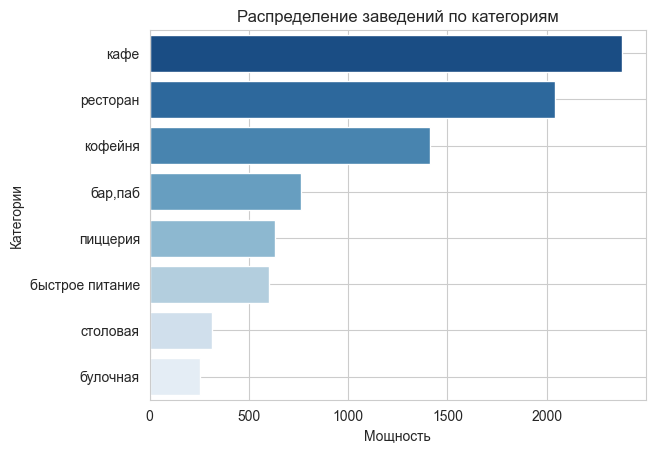

In [20]:
# sns.set_palette('summer')
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='category',
    x='values',     
    data=categories,
    palette='Blues_r'
)


ax.set_title('Распределение заведений по категориям')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)

# К сожалению, окружение ЯП настолько древнее, что, 
# возможно, ещё вскормлено самим Гвидо
# ошибка 'AxesSubplot' object has no attribute 'bar_label'
# вылетает при двух способах кинуть в бары цифры
# первый: ax.bar_label(ax.containers[0])

# второй 
# for i in ax.containers:
#     ax.bar_label(i,)
# Без окружения ЯП всё работает штатно

# Пытаюсь сделать это третьим способом

# for index, row in categories.iterrows():
    # ax.text(row.category, row.values, row.values,
           # color='white', ha='center')
# Тоже беспонтово
# Методы отсюда: 
# https://www.geeksforgeeks.org/how-to-show-values-on-seaborn-barplot/

## Анализ распределения заведений по категориям
<a id='2.1_total'></a>
Судя по полученным данным, преобладают кафе (2378), на втором месте - рестораны (2042). Вместе они занимают половину рынка общепита. 

Кофейни занимают третье место (1413), и их достаточно много. 

Оставшееся занимают бары/пабы, пиццерии, быстропит (более 500 заведений), столовые и булочные (менее 350 заведений). 

Можно ли говорить о невостребованности форматов с низким числом заведений? Пока нельзя сказать, что это так. Нужно посмотреть на их выручку как минимум.

<div class="alert alert-block alert-info"></div>

## 2.2 Количество посадочных мест по категориям 
<a id='2.2'></a>
1. Исследование числа посадочных мест по категориям заведений.

2. Построение визуализации.

3. Анализ распределения посадочных мест по категориям.

In [21]:
# Считаю места в заведениях по медианному значению, поскольку 
seats = (rest
              .pivot_table(
                  index='category',
                  values='seats', 
                  aggfunc=['median', 'mean']
                  
                
              )
             )
# Переименовал столбы, отсортировал данные в убывании
seats.columns = ['seats_median', 'seats_mean']
seats = seats.sort_values(by='seats_median', ascending=False)
seats

,seats_median,seats_mean
category,,
ресторан,86.0,121.892041
"бар,паб",82.5,124.532051
кофейня,80.0,111.199734
столовая,75.5,99.750000
быстрое питание,65.0,98.891117
кафе,60.0,97.512315
пиццерия,55.0,94.496487
булочная,50.0,89.385135


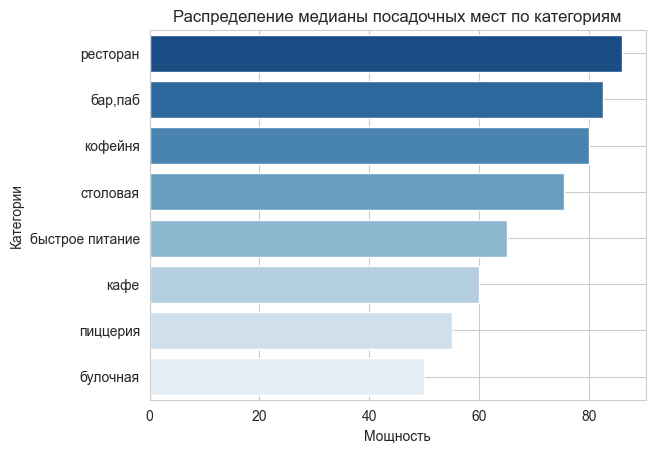

In [22]:
sns.set_style('whitegrid') 
ax = sns.barplot(
    y=seats.index, 
    x='seats_median', 
    data=seats,
    palette='Blues_r'
    
)

ax.set_title('Распределение медианы посадочных мест по категориям')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)


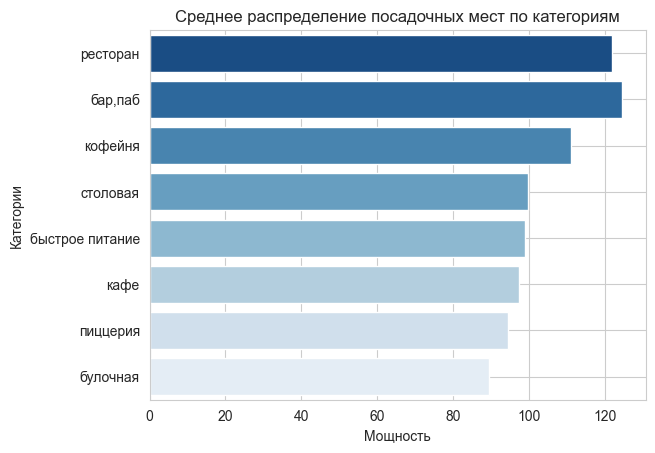

In [23]:
sns.set_style('whitegrid') 
ax = sns.barplot(
    y=seats.index, 
    x='seats_mean', 
    data=seats,
    palette='Blues_r'
    
)

ax.set_title('Среднее распределение посадочных мест по категориям')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)

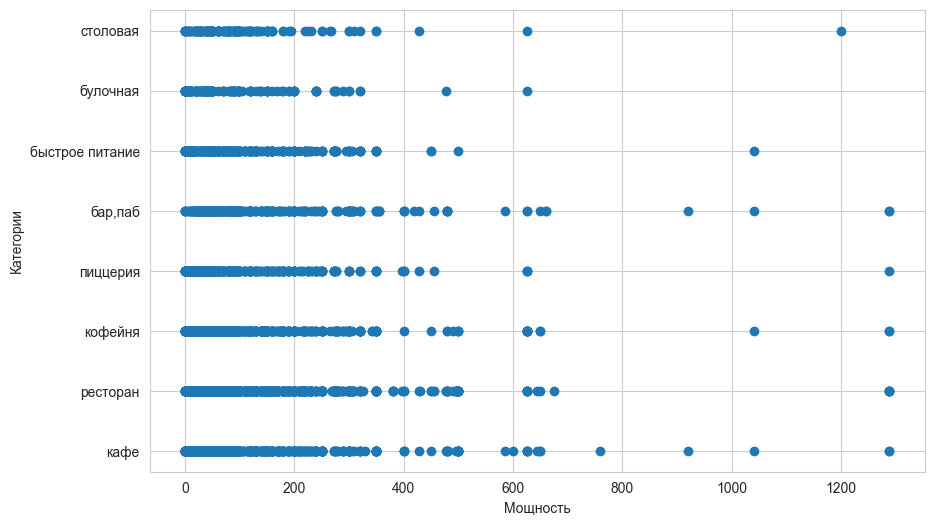

In [24]:
# Рассеяние групповое по местам для поиска выбросов
fig, ax = plt.subplots(figsize=(10, 6))
ax.scatter(x = rest['seats'], y = rest['category'])
plt.xlabel("Мощность")
plt.ylabel("Категории")
plt.show()

In [25]:
# Создаю фрейм с пропусками в столбе посадочных мест
# тут же считаю отношение
missed_seats = rest.groupby('category')[['seats', 'category']].count()
missed_seats['missed'] = (missed_seats['category'] - missed_seats['seats'])
missed_seats['ratio'] = round(missed_seats['missed'] / missed_seats['category'] * 100, 2)
missed_seats = missed_seats.sort_values(by='ratio',ascending=False)
missed_seats

,seats,category,missed,ratio
category,,,,
кафе,1218,2378,1160,48.78
столовая,164,315,151,47.94
кофейня,751,1413,662,46.85
булочная,148,256,108,42.19
быстрое питание,349,603,254,42.12
"бар,паб",468,765,297,38.82
ресторан,1269,2042,773,37.86
пиццерия,427,633,206,32.54


## Анализ распределения посадочных мест по категориям

<a id='2.2_total'></a>

В данных заметна разница между средним и медианой. Она объясняется выбросами, что подтверждает и диаграмма рассеяния, на которой видны такие большие числа, что сомнений в лишних цифрах нет. 

Для анализа я оставлю медианные значения, так как выбросы плохо влияют на среднее, однако тут упомяну статистику и по средним. 

Рестораны и бары/пабы занимают первое и второе места в обоих случаях. Рестораны 86 медианных мест против 121.94 средних. В пабах 82.5 медианных мест против 124.53 средних. Если взять средние значения, то именно бары лидируют с небольшой разницей: 


|Категория|Медиана|Среднее|
|---------|-------|-------|
|Ресторан |86     |121    |
|Бар/паб  |82     |124    |


Далее идут кофейни, столовые, быстропит, кафе, пиццерии и булочные. И тут стоит отметить, что ранее формату пиццерии или столовой больше подходили числа средние. Например, мы имеем:

|Категория|Медиана|Среднее|
|---------|-------|-------|
|Столовая |75     |99     |
|Пиццерия |55     |95     |


Для сокращения издержек площади снижаются и, соответствено, число посадочных мест уменьшается, но по данным категориям числа средние вызывают больше доверия. У них и выбросов меньше, что меньше повлияло на среднее.


Остальные категории (по медиане) вполне в рамках реальности.


|Категория|Медиана|Среднее|
|---------|-------|-------|
|Кофейня  |80     |111    |
|Быстропит|65     |98     |
|Кафе     |60     |97     |
|Булочная |50     |89     |


<hr>

### Выводы: 


1. О заведениях можно сделать вывод, что более всего посадочных мест имееют рестораны, бары и кофейни. 


Непонятно, что даст эта информация. Интересно было бы узнать ещё и их площади, арендную плату, средний чек, заполняемость, посещаемость. А просто так посадочные места ни о чём не говорят. 


2. Несмотря на то, что данные о посадке не являются полными, судить в целом о заведениях можно. Процентное отношение пропусков говорит, что у нас от 51% до 67% данных. Пусть какие-то из них некорректны, но общая картина не может разительно отличаться. 


3. Система фиксации информации требует пересмотра. Возможность добавлять данные - хорошо, но нужен фильтр, который не пропустит явно ошибочные числа, а то и даже не пропустит неполную информацию. Это вопросы к системам сбора.

## 2.3 Соотношение сетевых и несетевых заведений

<a id='2.3'></a>

In [26]:
# Создаю счётчик сетевых и несетевых заведений
count_by_chain = (rest.
                  pivot_table(index=['chain'],
                              values='address',
                              aggfunc='count')
                  .sort_values(by = 'address', ascending=False)
                 )
count_by_chain.columns= ['values']
count_by_chain

,values
chain,
0,5200
1,3205


In [27]:
fig = go.Figure(data=
                [go.Pie(labels=['Несетевые','Сетевые'], 
                        values=count_by_chain['values'])]
               )
fig.update_layout(title='Распределение количества заведений по сетевому признаку')  

fig.show() 

# Увы, поменять цвета не удалось. 
# В одной лабе настолько разные коды в разных методах, будто писали их стопицот людей без к.-л. согласования
# Забил и не хочу даже разбираться.

In [28]:
# Ради интереса проверяю некоторые сети.
names = ['мак дональдс', 'мак доналдс', 
         "mcdonald's", 'mcdonalds',
         'kfc', "кфс", 'subway', 
         'вкусно и точка', "бургер кинг", 
         "burger king"]


# print(names)
# print()


check_list = []
try:
    for name in rest['name']:
        if name.lower() in names:
            if name not in check_list:
                check_list.append(name)
    
except:
    print('Что-то сломалось')
    
check_list 

['Бургер Кинг']

## Анализ отношения сетевых и несетевых заведений
<a id='2.3_total'></a>

Сетевые заведения занимают 38.1% от всего числа заведений общепита. В абсолютных значениях это 3205 единиц. Поскольку данные даны на лето военно-санкционного года, часть сетевых заведений не включена. Причём не включены даже рестораны выкупленные - "Вкусно и точка". По данным Макдака в Москве на 2022 год насчитывалось 126 точек. KFC - 125. Subway более 20 единиц. 

## 2.4 Распределение сетевых заведений по категориям
<a id='2.4'></a>
Нахожу частоту.

In [29]:
# Два фрейма, разбитые по принадлежности к сетям.
chain = rest[rest['chain'] == 1]
chainless = rest[rest['chain'] == 0]

In [30]:
# Series с данными о заведениях сетевых по категориям
chain_categories = (chain
                    .pivot_table(
                        index='category',
                        values='address',
                        aggfunc='count'
                    )
                   )
chain_categories.columns = ['in_chain']
chain_categories = chain_categories.sort_values(by='in_chain', ascending=False)
chain_categories

,in_chain
category,
кафе,779
ресторан,730
кофейня,720
пиццерия,330
быстрое питание,232
"бар,паб",169
булочная,157
столовая,88


In [31]:
# Series с данными о заведениях вне сетей по категориям
chainless_categories = (chainless
                    .pivot_table(
                        index='category',
                        values='address',
                        aggfunc='count'
                    )
                   )
chainless_categories.columns = ['not_in_chain']
chainless_categories = chainless_categories.sort_values(by='not_in_chain', ascending=False)
chainless_categories

,not_in_chain
category,
кафе,1599
ресторан,1312
кофейня,693
"бар,паб",596
быстрое питание,371
пиццерия,303
столовая,227
булочная,99


In [32]:
# Сначала создам фрейм с данными по категориям и принадлежности к сетям
categories_by_chain = pd.concat([chainless_categories, chain_categories], axis=1)

# Затем сделаю столб с разницей. Абсолют не нужен, т. к. 
# он не покажет перевес сетевых по категории
categories_by_chain['difference'] = categories_by_chain['not_in_chain'] - categories_by_chain['in_chain']

# Ну и отношение, конечно
categories_by_chain['ratio_in_cat'] = round(
    categories_by_chain['in_chain'] / categories_by_chain['not_in_chain'], 2)


categories_by_chain['ratio_by_all'] = round(
    categories_by_chain['in_chain'] / missed_seats['category'], 2)


categories_by_chain

,not_in_chain,in_chain,difference,ratio_in_cat,ratio_by_all
category,,,,,
кафе,1599,779,820,0.49,0.33
ресторан,1312,730,582,0.56,0.36
кофейня,693,720,-27,1.04,0.51
"бар,паб",596,169,427,0.28,0.22
быстрое питание,371,232,139,0.63,0.38
пиццерия,303,330,-27,1.09,0.52
столовая,227,88,139,0.39,0.28
булочная,99,157,-58,1.59,0.61


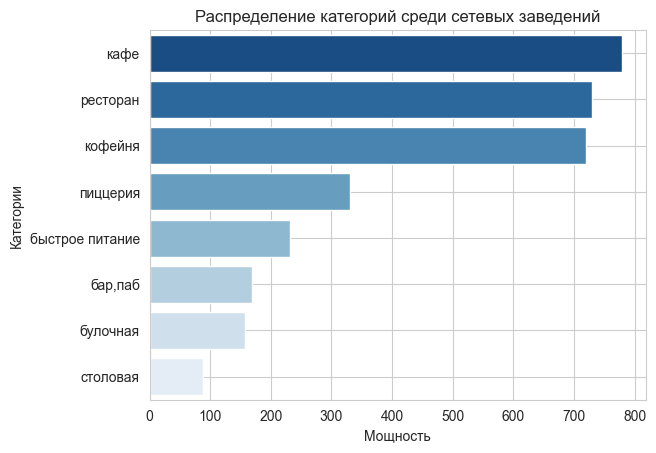

In [33]:
# График распределения сетевых по категориям
categories_by_chain = categories_by_chain.sort_values(by='in_chain', ascending=False)

sns.set_style('whitegrid') 
ax = sns.barplot(
    y=categories_by_chain.index, 
    x='in_chain', 
    data=categories_by_chain.sort_values('in_chain', ascending=False),
    palette='Blues_r'
    
)

ax.set_title('Распределение категорий среди сетевых заведений')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)


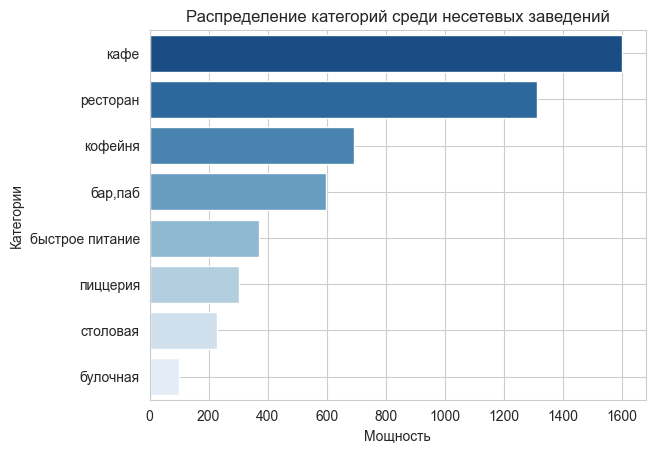

In [34]:
# График распределения несетевых по категориям
categories_by_chain = categories_by_chain.sort_values(by='not_in_chain', ascending=False)

sns.set_style('whitegrid') 
ax = sns.barplot(
    y=categories_by_chain.index, 
    x='not_in_chain', 
    data=categories_by_chain,
    palette='Blues_r'
    
)

ax.set_title('Распределение категорий среди несетевых заведений')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)


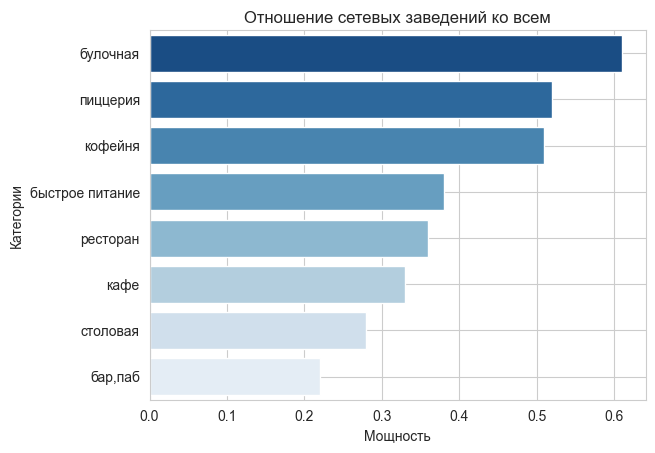

In [35]:
# График отношения сетевых ко всем
categories_by_chain = categories_by_chain.sort_values(by='ratio_by_all', ascending=False)

sns.set_style('whitegrid') 
ax = sns.barplot(
    y=categories_by_chain.index, 
    x='ratio_by_all', 
    data=categories_by_chain,
    palette='Blues_r'
    
)

ax.set_title('Отношение сетевых заведений ко всем')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)


In [36]:
# Фрейм для разибвки данных по категориям на 
# принадлежность к сети. 
# Заменяем данные в цепи на два разных состояния
# в зависимости от того, True или False (1 или 0) в 
# сети. Далее сводник, где в индексы идут категории и 
# сетевая принадлежность, в значениях названия,
# которые мы считаем. Переименовываем колонки, 
# сбрасываем индекс и вуаля.

# Код не мой. Подсказали. Самого таки не научили, увы.
rest_categories = (rest
                   .replace({'chain':{True:'Сетевое', False: 'Не сетевое'}})
                   .pivot_table(
                       index=['category', 'chain'], 
                       values='name', 
                       aggfunc='count')
                   .rename(columns={'name' : 'values'})
                   .reset_index()
                  )

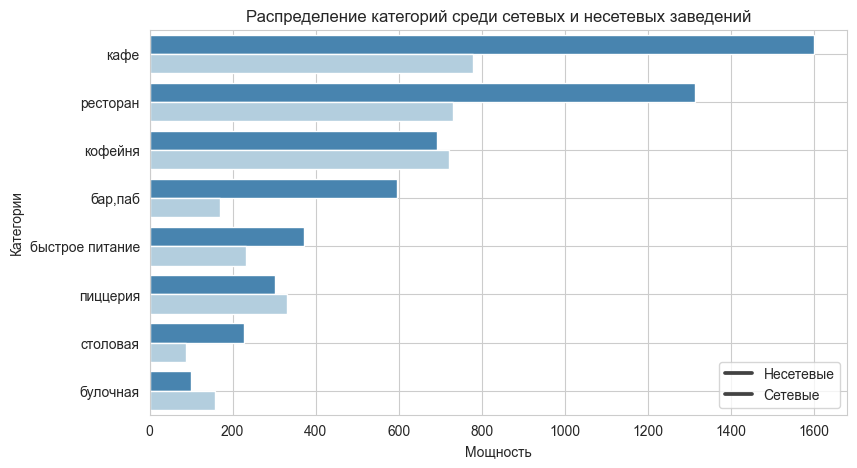

In [37]:
sns.set_style('whitegrid') 
plt.figure(figsize=(9, 5))
sns.barplot(x='values',
            y='category',
            data=rest_categories.sort_values(by='values', ascending=False),
            hue='chain',
            palette='Blues_r'
)

plt.title('Распределение категорий среди сетевых и несетевых заведений')
plt.ylabel('Категории')
plt.xlabel('Мощность')

# К сожалению, если в легенду прописать слова, то цвет в ней становится единым
# потому вкупе с таблицей решил оставить так. Всяко лучше, чем 0 1. 
# Настроить не получилось ни палеткой, ни колором.
plt.legend(['Несетевые', 'Сетевые'])
plt.grid(True)


## Анализ распределения сетевых заведений по категориям
<a id='2.4_total'></a>
Заведения, где сетевые в меньшем количестве: 

|Категория      |Несетевые|Сетевые|Разница|Отношение сетевых к несетевым|Отношение сетевых ко всем в категории|
|---------------|---------|-------|-------|-----------------------------|-------------------------------------|
|Кафе           |1599     |779    |820    |0.49                         |0.33                                 |
|Ресторан       |1313     |730    |583    |0.56                         |0.36                                 |
|Бар, паб       |596      |169    |427    |0.28                         |0.22                                 |
|Быстрое питание|371      |232    |139    |0.63                         |0.38                                 |
|Столовая       |227      |88     |139    |0.39                         |0.28                                 |



Заведения, где сетевые преобладают: 

|Категория      |Несетевые|Сетевые|Разница|Отношение сетевых к несетевым|Отношение сетевых ко всем в категории|
|---------      |---------|-------|-------|-----------------------------|-------------------------------------|
|Кофейня        |693      |720    |-27    |1.04                         |0.51                                 |
|Пиццерия       |303      |330    |-27    |1.09                         |0.52                                 |
|Булочная       |99       |157    |-58    |1.59                         |0.61                                 |


1. Наибольшее число сетевых заведений среди кафе, ресторанов и кофеен. 


2. Сетевых заведений в основном меньше, чем несетевых. Наменьшее отношение 0.28, наибольшее - 0.63. Их  доли от общего числа заведений в категории колеблются от 0.22 до 0.38. 


3. Среди сетевых заведений три категории имеют число больше, чем несетевые. Их отношение к несетевым от 1.04 до 1.59. А их доли от общего числа заведений в категории колеблются от 0.51 до 0.61.


### Выводы: 

**Исходя из этого можно сделать вывод, что сетевой бизнес более развит среди кофеен, пиццерий и булочных. А их число превышает число заведений, не входящих в сети.** 

Почему я так считаю? В булочных, например, в 1.5 раза больше сетевиков. И их больше половины от всех заведений категории, почти 2/3. Бесспорно, рестораны лидер по числу сетевиков, но лишь за счёт огромного числа самих ресторанов. Их доля в категории едва больше 1/3. Именно это позволяет мне сделать означенный выше вывод.

Может ли такая информация играть роль при создании бизнеса - не ясно на текущих данных.


Поскольку доли остальных категорий значительно меньше, по всей видимости, франшиза не лучшее явление в них. Опять же нужно помнить, что мы не имеем данных о всех сетях. Если в текущих данных доля сетевых 38.1%, то с самым пессимистичным сценарием подсчёта пропавших из рейтинга сетей их уже 43.75%. А скорее все 45%. И отношение быстропита станет совсем иным. Как к несетевым, так и общему числу. 



##  2.5 Определение ТОП-15 сетей с наибольшим числом точек
<a id='2.5'></a>

1. Известны ли широко эти сети? 

2. Есть ли какой-то признак, который их объединяет? 

3. К какой категории заведений они относятся?

In [38]:
# top-15
# Сводник из цепей, где индексом названия, значениями адреса
# и агрегируем счётчик. Сортировка по числу адресов вниз
# и ограничение в 15 записей
top = (
    chain
    .pivot_table(
        index='name', # ['category', 'seats', 'avg_bill'],
        values='address', 
        aggfunc='count')
    .sort_values(by='address', ascending=False)
    .head(15)
    .reset_index()
)

top.columns =  ['name', 'total_points'] # 'category', 'seats', 'avg_bill'
top

,name,total_points
0,Шоколадница,120
1,Домино'С Пицца,76
2,Додо Пицца,74
3,One Price Coffee,71
4,Яндекс Лавка,69
5,Cofix,65
6,Prime,50
7,Хинкальная,44
8,Кофепорт,42
9,Кулинарная Лавка Братьев Караваевых,39


In [39]:
top = top.replace('Кулинарная Лавка Братьев Караваевых','КЛБ Караваевых')

# Много места на визуале занимает

In [40]:
fig = go.Figure(
    data=
    [go.Pie(
        labels=top['name'], 
        values=top['total_points'], 
        pull=[0.02, 0.08, 0.0]
    )]
)
fig.update_layout(title='Топ-15 сетевых заведений')          


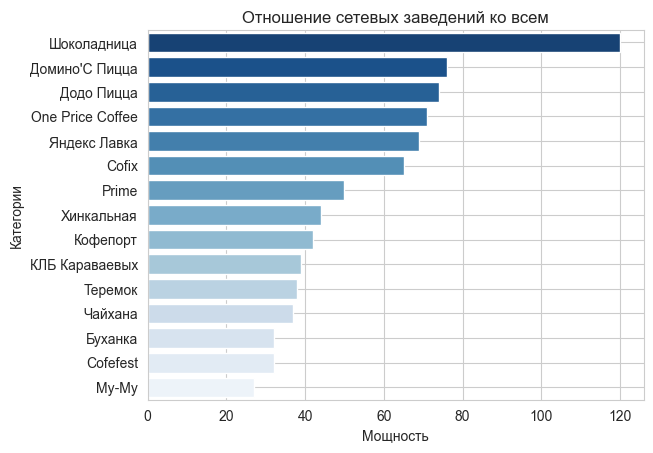

In [41]:
# График отношения сетевых ко всем
categories_by_chain = categories_by_chain.sort_values(by='ratio_by_all', ascending=False)

sns.set_style('whitegrid') 
ax = sns.barplot(
    y='name', 
    x='total_points', 
    data=top,
    palette='Blues_r'
    
)

ax.set_title('Отношение сетевых заведений ко всем')
ax.set_ylabel('Категории')
ax.set_xlabel('Мощность')
plt.grid(True)


Что может объединять эти сети? 

1. Средний чек.

2. Посадочные места.

3. Категории. 

4. Бенефициары.

5. Типы кухонь (для ресторанов, баров).

6. Позиционирование себя на рынке, привлечение одной ЦА.

7. Доставка блюд по заказу.

8. Национальная принадлежность.

9. Разбросанность точек по городу.

10. Наличие точек всех 15 сетей во всех АО Москвы. Или хотя бы большей их части.

Много можно придумать. 

В текущей ситуации найти объединяющий фактор не представляется возможным. Они находтся в разных местах города. Разве что это. Чек сравнить нереально, поскольку где-то это прямо чек, а где-то цена за чашку кофе. Посадочные места сравнивать тоже не лучшая затея. 

И в эту минуту их объединяет интерес моих инвесторов. То есть, тот факт, что они приносят деньги. Ну и да, они сети. 

Проверю категории

In [42]:
pd.set_option('max_colwidth', 200)
chain.query('name in @top["name"]').groupby('name')['category'].unique().reset_index()


,name,category
0,Cofefest,"[кофейня, кафе]"
1,Cofix,[кофейня]
2,One Price Coffee,[кофейня]
3,Prime,"[ресторан, кафе]"
4,Буханка,"[булочная, кофейня, кафе]"
5,Додо Пицца,[пиццерия]
6,Домино'С Пицца,[пиццерия]
7,Кофепорт,[кофейня]
8,Му-Му,"[кафе, ресторан, кофейня, быстрое питание, пиццерия, столовая, бар,паб]"
9,Теремок,"[ресторан, быстрое питание]"


## Анализ ТОП-15 сетей
<a id='2.5_total'></a>

1. Известность заведений. Поскольку вопрос был задан о том, знаю ли их я, то стоит отметить моё проживание вне Москвы. Однако наездами я посещаю её. В частности - попить кофе и съесть пиццу. 


**На слуху по стране**:

- Додо Пицца

- Шоколадница

- Домино'с Пицца

- Яндекс Лавка

Эти за счёт присутствия. Да и то не везде. 

**Знаю лично я такие названия**:

- Му-му

- Хинкальная

- Чайхана

- Теремок


2. Наличие объединяющих признаков. 

Не найдено, кроме того, что они все сетевые. За исключением Доминос пиццы - отечественные компании, если не ошибаюсь.





3. В ТОП-15 входят все категории. Однако нужно отметить, что преобладают кафе, кофейни и рестораны. Хинкальная и му-му собрали в себя всё, что можно. Но по сути это не даёт повода считать, что бары или столовые входят в топ. Как и булочные, бысропит и пиццерии. 

Это и не удивительно. Как мы помним, тройка лидеров по числу заведений - кафе, рестораны и кофейни. В том числе при делении на сети.

## 2.6 Изучение администраивных районов
<a id='2.6'></a>

Сколько заведений в районе? Как присутствуют категории? 



In [43]:
districts_all = (
    rest
    .pivot_table(
        index='district', 
        values='address',
        aggfunc='count'
    )
    
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)
districts_all

districts_all = districts_all.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)
districts_all

,district,amount
0,ЦАО,2242
1,САО,899
2,ЮАО,892
3,СВАО,891
4,ЗАО,851
5,ВАО,798
6,ЮВАО,714
7,ЮЗАО,709
8,СЗАО,409


In [44]:
districts_cat = (
    rest
    .pivot_table(
        index=['district', 'category'], 
        values='address',
        aggfunc='count'
    )
    
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_cat = districts_cat.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)
districts_cat

,district,category,amount
0,ЦАО,ресторан,670
1,ЦАО,кафе,464
2,ЦАО,кофейня,428
3,ЦАО,"бар,паб",364
4,ЮВАО,кафе,282
...,...,...,...
67,СЗАО,"бар,паб",23
68,СЗАО,столовая,18
69,ЮЗАО,столовая,17
70,ЮВАО,булочная,13


In [45]:
fig = px.bar(
    districts_cat.sort_values(by='amount', ascending=True), 
    x="amount",
    y="district", 
    color="category", 
    title="Распредение категорий по округам",
 
)

fig.update_layout(xaxis={'categoryorder':'total descending'}) 

fig.show()



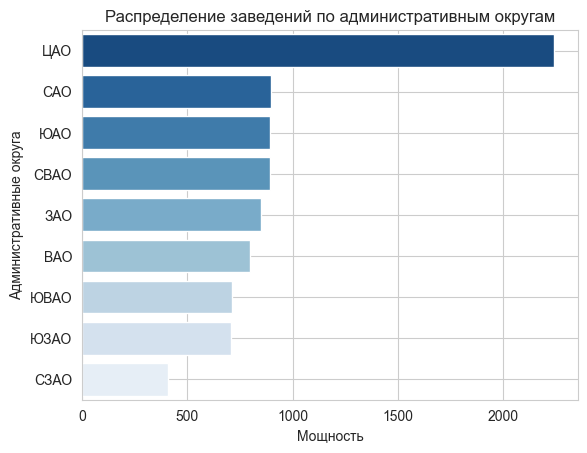

In [46]:
# График распределения заведений по округам
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_all,
    palette='Blues_r'
    
)

ax.set_title('Распределение заведений по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)


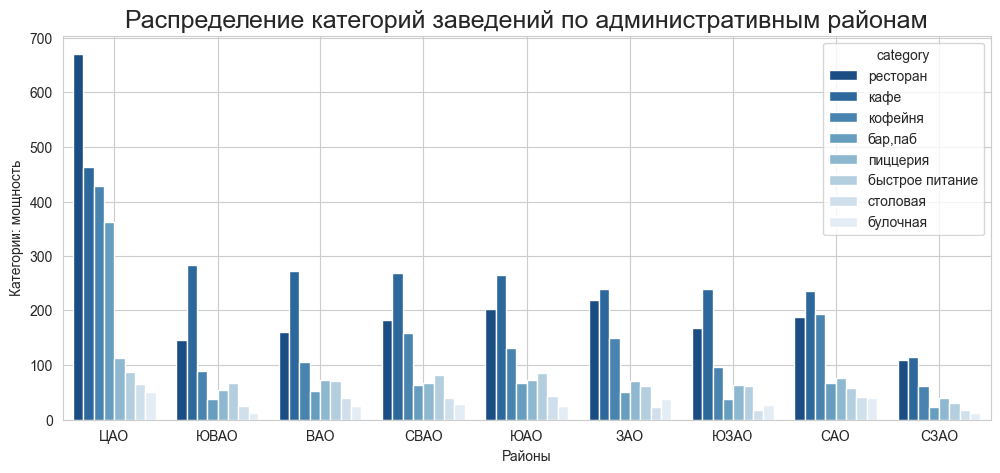

In [47]:
# График распределения категорий по административным округам
sns.set_style('whitegrid') 
plt.figure(figsize=(12, 5))
sns.barplot(y='amount',
            x='district',
            data=districts_cat.sort_values(by='amount', ascending=False),
            hue='category',
            palette='Blues_r'
)
sns.set(font_scale=1.5)
plt.title('Распределение категорий заведений по административным районам')
plt.xlabel('Районы')
plt.ylabel('Категории: мощность')


plt.grid(True)


In [48]:
# Фрейм для всех категорий сетевых заведений
districts_all_ch = (
    chain
    .pivot_table(
        index='district', 
        values='address',
        aggfunc='count'
    )
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_all_ch = districts_all_ch.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)

display(districts_all_ch)



,district,amount
0,ЦАО,875
1,ЗАО,376
2,САО,347
3,СВАО,334
4,ЮАО,312
5,ЮЗАО,302
6,ВАО,283
7,ЮВАО,220
8,СЗАО,156


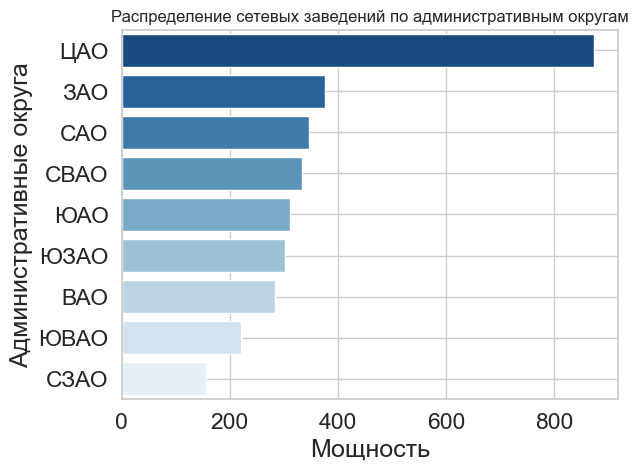

In [49]:
# График распределения сетевых заведений по округам
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_all_ch,
    palette='Blues_r'
    
)
sns.set(font_scale=1)
ax.set_title('Распределение сетевых заведений по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)

# ------------------------------------------------------------------------



,district,amount
0,ЦАО,1367
1,ЮАО,580
2,СВАО,557
3,САО,552
4,ВАО,515
5,ЮВАО,494
6,ЗАО,475
7,ЮЗАО,407
8,СЗАО,253


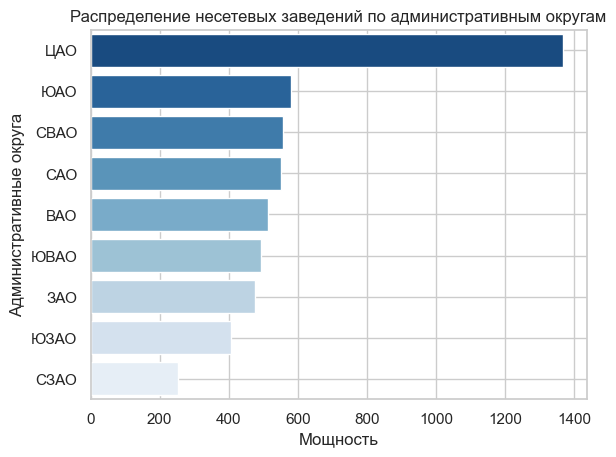

In [50]:
# Фрейм для всех категорий несетевых заведений
districts_all_chs = (
    chainless
    .pivot_table(
        index='district', 
        values='address',
        aggfunc='count'
    )
    
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_all_chs = districts_all_chs.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)

display(districts_all_chs)

# График распределения несетевых заведений по округам
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_all_chs,
    palette='Blues_r'
    
)

ax.set_title('Распределение несетевых заведений по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)


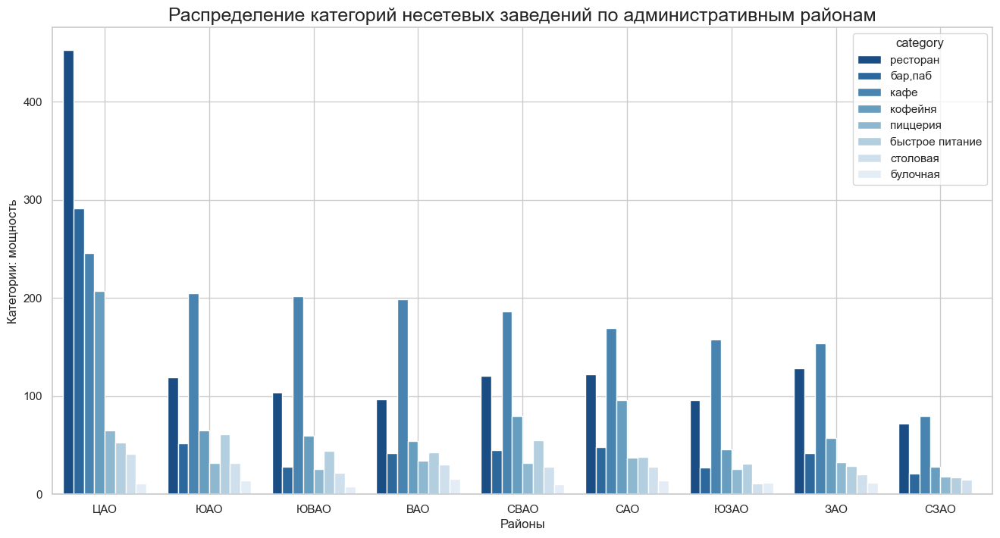

In [51]:
# Фрейм несетевых заведений для графиков
districts_chs_cat = (
    chainless
    .pivot_table(
        index=['district', 'category'], 
        values='address',
        aggfunc='count'
    )
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_chs_cat = districts_chs_cat.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)


# График распределения категорий несетевых заведений по округам

sns.set_style('whitegrid') 
plt.figure(figsize=(16, 8))
sns.barplot(y='amount',
            x='district',
            data=districts_chs_cat.sort_values(by='amount', ascending=False),
            hue='category',
            palette='Blues_r'
)
sns.set(font_scale=1.5)
plt.title('Распределение категорий несетевых заведений по административным районам')
plt.xlabel('Районы')
plt.ylabel('Категории: мощность')


plt.grid(True)
# plt.xticks(rotation=45)

plt.show()

In [52]:
# Хочу сводник по сетевому статуту по округам

districts_all_chsch = districts_all_ch.merge(districts_all_chs,  
                                             how='inner', 
                                             left_on='district', 
                                             right_on='district')
districts_all_chsch.columns = ['district', 'in_chain', 'not_in_chain']
districts_all_chsch

,district,in_chain,not_in_chain
0,ЦАО,875,1367
1,ЗАО,376,475
2,САО,347,552
3,СВАО,334,557
4,ЮАО,312,580
5,ЮЗАО,302,407
6,ВАО,283,515
7,ЮВАО,220,494
8,СЗАО,156,253


## Анализ распределения заведений по административным районам

<a id='2.6_total'></a>


1. В данных присутствуют классические районы Москвы: ВАО, ЗАО, САО, СВАО, СЗАО, ЦАО, ЮАО, ЮВАО, ЮЗАО.


<hr>

2. Общее число заведений больше всего в ЦАО - 2242. Центр города. Развитые туристские маршруты, деловая жизнь. Ничем иным не обусловлено такое отличие.

    На втором месте САО - 900 заведений. Третье и четвёртое у ЮАО - 892 и СВАО - 891. Замыкает пятёрку ЗАО - 851 заведение. ВАО, ЮВАО, ЮЗАО дают от 798 до 709, а СЗАО весьма сильно отстаёт, имея всего 409 точек общепита. Причина не совсем ясна, так как ни Строгино, ни Щукино не являются гетто и  прочими возможными факторами. 

    При разбивке на сети и не сети результат сильно отличается. Так, лидирует в обоих случаях ЦАО 875 и 1367 соответственно. 

    **Первая пятёрка выглядит так:**


- в сетевых  ЦАО - 875, ЗАО - 376, САО - 347, СВАО - 334, ЮАО - 312;

- в несетевых ЦАО - 1367, ЮАО - 580, СВАО - 557, САО - 553, ВАО - 515.


Как видим, картина разительно отличается. Запад, занимая 2-е место в сетевых, не вошёл в ТОП-5 несетевых вообще. Он занимает 7-е место. Север и Северо-Восток поменялись местами: 3-е и 4-е места на 4-е и 3-е. Юг с 5-го в сетях вырвался на 2-е в несетевых, а в место Запада вошёл Восток, заняв 5-е место. При этом в списке сетевых он занимает 7-е место. 

<hr>

3. Теперь о категориях. Первая тройка та же: ресторан, кафе, кофейня. Однако ресторан лидер только в ЦАО. Ниже данные в таблице:

|Округ|1-е место|2-е место|3-е место|Близко к 3-му      |
|-----|---------|---------|---------|-------------------|
|ЦАО  |Ресторан |Кафе     |Кофейня  |Бар/Паб            |
|ЮВАО |Кафе     |Ресторан |Кофейня  |Быстропит          |
|ВАО  |Кафе     |Ресторан |Кофейня  |Бар/Паб, пиццерия  |
|СВАО |Кафе     |Ресторан |Кофейня  |Нет                |
|ЮАО  |Кафе     |Ресторан |Кофейня  |Нет                |
|ЗАО  |Кафе     |Ресторан |Кофейня  |Нет                |
|ЮЗАО |Кафе     |Ресторан |Кофейня  |Пиццерия, быстропит|
|САО  |Кафе     |Кофейня  |Ресторан |Нет                |
|СЗАО |Кафе     |Ресторан |Кофейня  |Пицца              |


Заметно, что лидер по городу - кафе. Второе место за ресторанами. И лишь раз, на Севере, рестораны ушли на 3-е место, уступив 2-е кофейне.

## 2.7 Визуализация распределения средних рейтингов по категориям заведений
<a id='2.7'></a>
Сильно ли различаются усреднённые рейтинги в разных типах общепита?

In [53]:
# Собираю рейтинги в среднем и медианном значениях. 
rating_cat = (
    rest
    .pivot_table(
        index = 'category', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
    
  
)
rating_cat.columns = ['mean', 'median']
rating_cat = (
    rating_cat
    .sort_values(by='mean', ascending=False)
    .reset_index()
)


rating_cat

,category,mean,median
0,"бар,паб",4.387712,4.4
1,пиццерия,4.301264,4.3
2,ресторан,4.290402,4.3
3,кофейня,4.277282,4.3
4,булочная,4.268359,4.3
5,столовая,4.211429,4.3
6,кафе,4.123886,4.2
7,быстрое питание,4.050249,4.2


Поскольку значения порой округлены не очень точно, оставлю средние.

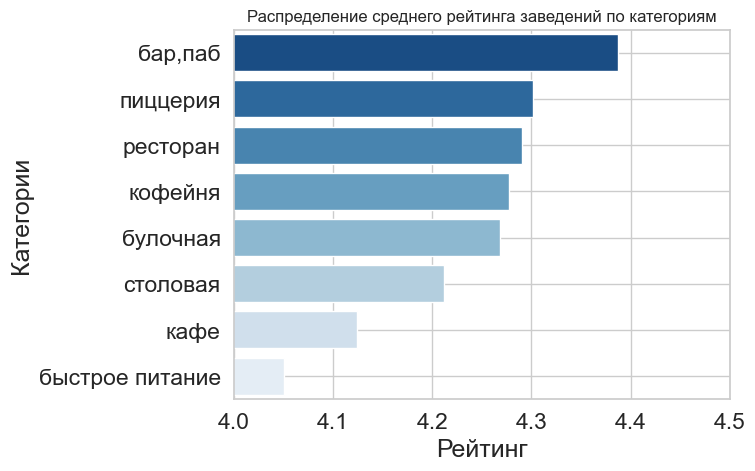

In [54]:
# График средних значений рейтинга по категориям
sns.set_style('whitegrid') 
ax = sns.barplot(
    x='mean', 
    y='category', 
    data=rating_cat.sort_values(by='mean', ascending=False),
    palette='Blues_r'
    
)
ax.set_xlim(4, 4.5)
sns.set(font_scale=1)
ax.set_title('Распределение среднего рейтинга заведений по категориям')
ax.set_ylabel('Категории')
ax.set_xlabel('Рейтинг')
plt.grid(True)

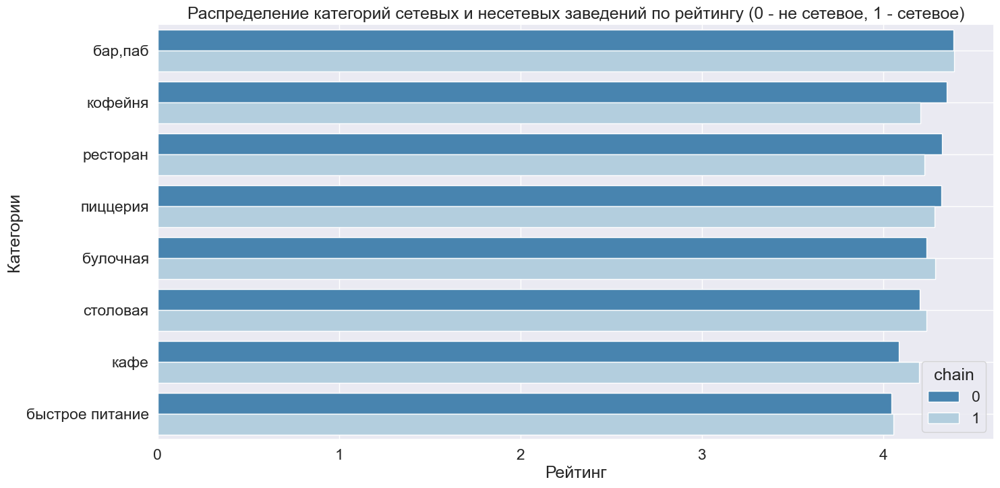

In [55]:
# Собрал рейтинги по признаку сети
rating = (rest
          .groupby(['category', 'chain'])['rating'].mean()
          .reset_index()
         )

# А теперь визуал

sns.set_style('whitegrid') 
plt.figure(figsize=(16, 8))
sns.set(font_scale=1.5)
sns.barplot(y='category',
            x='rating',
            data=rating.sort_values(by='rating', ascending=False),
            hue='chain',
            palette='Blues_r'
)

plt.title('Распределение категорий сетевых и несетевых заведений по рейтингу (0 - не сетевое, 1 - сетевое)')
plt.xlabel('Рейтинг')
plt.ylabel('Категории')


plt.grid(True)



In [56]:
rating

,category,chain,rating
0,"бар,паб",0,4.386913
1,"бар,паб",1,4.390533
2,булочная,0,4.240404
3,булочная,1,4.285987
4,быстрое питание,0,4.046361
5,быстрое питание,1,4.056466
6,кафе,0,4.087492
7,кафе,1,4.198588
8,кофейня,0,4.350505
9,кофейня,1,4.206806


## Анализ распределения средних рейтингов по категориям заведений
<a id='2.7_total'></a>

Рейтинг всех категорий выше 4 баллов. Быстрое питание превысило 4 балла на 0.5 и явный аутсайдер.

Лидируют бары/пабы с рейтингом 4.39. Далее идут пиццерии и рестораны с разницей в одну десятую балла - 4.30 и 4.29.

Рейтинг кофеен 4.28 (4-е место), а кафе - 4.12 (7-е место). А мы помним тройку лидеров по числу заведений: кафе, рестораны и кофейни.

Что касается разделения на сети и не сети, то тут оценки почти совпадают, но разница всё же есть. Так, бары и пабы идут с разницей в 4 тысячных (выше у сетей), у быстрого питания разница в 1 сотую (выше у сетей). У всех остальных разница более заметна. Причём сдвиг меняется.

У кафе, столовых и булочных выше рейтинг в сетях: на 11 сотых, 3 сотых и 4 сотых соответственно. 


А в кофейнях, ресторанах, пиццериях рейтинг выше у несетевых: 15 сотых, 10 сотых и 4 сотых соответственно. 

Нельзя сделать однозначный вывод о том, какие заведения лучше работают в сети, а какие - нет. Но, если брать за основу данные, которые есть у нас сейчас, можно считать, кофейню лучше открывать по франшизе. 



## 2.8 Фоновая картограмма (хороплёт) со средним рейтингом заведений каждого района

<a id='2.8'></a>
Границы районов Москвы, которые встречаются в датасете, хранятся в файле admin_level_geomap.geojson (https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson).

In [57]:
# Импортирую библиотеку для построения карт


# Задаю широту и долготу
# moscow_lat - широта центра Москвы, moscow_lng - долгота центра Москвы
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаю объект m – карту с центром в точке с координатами [moscow_lat, moscow_lng]
m = folium.Map(location=[moscow_lat, moscow_lng])


In [58]:
# Подключаю модуль для работы с JSON-форматом

# читаю файл и сохраняю в переменной
try:
    with open('admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)
except:
    with open('/datasets/admin_level_geomap.geojson', 'r') as f:
        geo_json = json.load(f)

print(json.dumps(geo_json, indent=2, ensure_ascii=False, sort_keys=True))

{
  "features": [
    {
      "geometry": {
        "coordinates": [
          [
            [
              [
                37.8756653,
                55.825342400000004
              ],
              [
                37.876001599999995,
                55.8249027
              ],
              [
                37.8730967,
                55.8237936
              ],
              [
                37.8689418,
                55.8228697
              ],
              [
                37.869206999999996,
                55.822363200000005
              ],
              [
                37.868322500000005,
                55.822211100000004
              ],
              [
                37.867472,
                55.823703
              ],
              [
                37.86851090000001,
                55.82391880000001
              ],
              [
                37.87046039999999,
                55.8242706
              ],
              [
                37.87172779999

In [59]:
# Создаю фрейм для карты
rating_for_district = rest.groupby('district', as_index=False)['rating'].agg('mean')

# Импортирую карты и хороплёт из библиотеки

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423

# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и рейтинги, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=rating_for_district,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m)

m

## 2.9 Создание кластеров с заведениями датасета на карте

<a id='2.9'></a>

In [60]:
# Импортирую плагин создания кластеров

moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаю объект m – карту с центром в точке с координатами [moscow_lat, moscow_lng]
m = folium.Map(location=[moscow_lat, moscow_lng])

# Создаю пустой кластер и добавляю его на карту
marker_cluster = MarkerCluster().add_to(m)

# Пишу функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяю функцию create_clusters() к каждой строке (axis=1) датафрейма
rest.apply(create_clusters, axis=1)

m

## 2.10 Топ-15 улиц по количеству заведений
<a id='2.10'></a>
График распределения количества заведений и их категорий по этим улицам. 

In [61]:
# Топ-15 улиц по числу заведений на них
top_streets = (
    rest
    .pivot_table(
        index='street',
        values='address',
        aggfunc='count'
    )
    # .reset_index()
    .sort_values(by='address', ascending=False)
    .head(15)
)
top_str = list(top_streets.index)
# top_streets.columns = ('amount')
top_streets

,address
street,
проспект Мира,184
Профсоюзная улица,122
проспект Вернадского,108
Ленинский проспект,107
Ленинградский проспект,95
Дмитровское шоссе,88
Каширское шоссе,77
Варшавское шоссе,76
Ленинградское шоссе,70


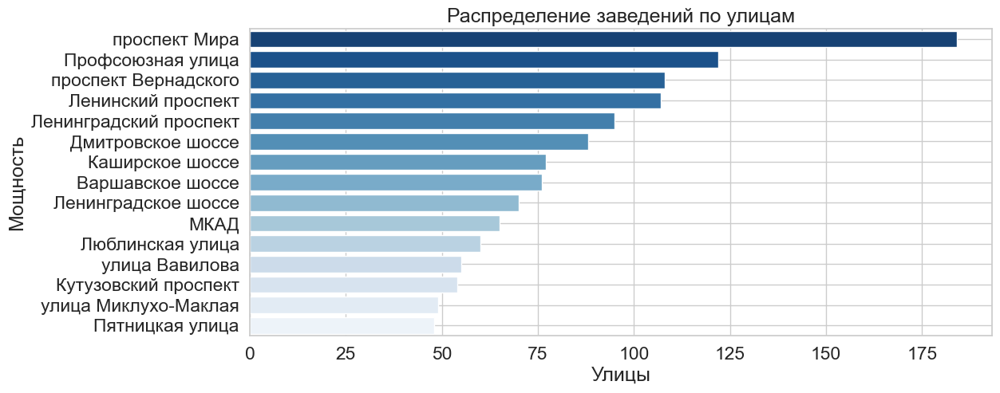

In [62]:
# График распределения категорий по улицам 
sns.set_style('whitegrid') 
plt.figure(figsize=(12, 5))
sns.barplot(y=top_streets.index,
            x='address',
            data=top_streets.sort_values(by='address', ascending=False),
            # hue='category',
            palette='Blues_r'
)

plt.title('Распределение заведений по улицам')
plt.xlabel('Улицы')
plt.ylabel('Мощность')


plt.grid(True)

In [63]:
top_street = rest.query('street in @top_str')
top_street.sample(2)

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
6830,Хинкальная,кафе,"Москва, проспект Вернадского, 41, стр. 3",Западный административный округ,NaN,55.674461,37.504794,4.1,NaN,NaN,NaN,NaN,1,250.0,проспект Вернадского,NaN
1928,Шоколадница,кофейня,"Москва, Дмитровское шоссе, 13А",Северный административный округ,пн-пт 08:00–23:00; сб 10:00–23:00; вс 10:00–22:00,55.818321,37.573723,4.2,средние,Цена чашки капучино:249–284 ₽,NaN,266.0,1,190.0,Дмитровское шоссе,False


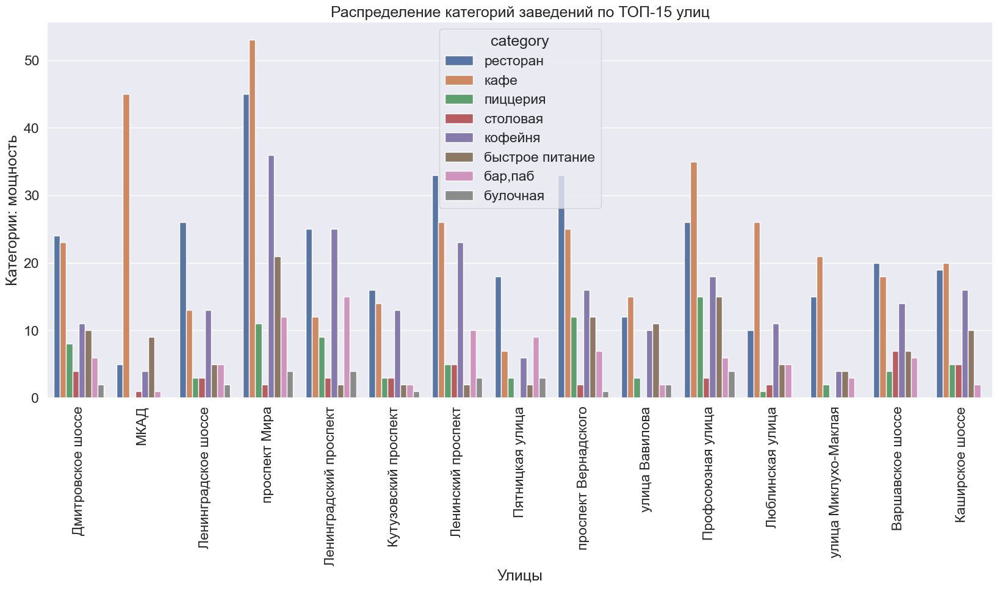

In [64]:
sns.set_style('whitegrid') 
# sns.cubehelix_palette(start=.5, rot=-.5, as_cmap=True) # - не работает
# sns.dark_palette("#69d", reverse=True, as_cmap=True) # - не работает
plt.figure(figsize=(20, 8))
sns.set(font_scale=1.5)
sns.countplot(x='street', 
              hue='category', 
              data=top_street) #, palette='Blues_r' # - с этим кодом график красивый, 
                                                           # но малочитаем http://joxi.ru/eAOjgWVtGjq0b2
plt.xticks(rotation=90)

plt.title('Распределение категорий заведений по ТОП-15 улиц')
plt.xlabel('Улицы')
plt.ylabel('Категории: мощность')

plt.show()

## Анализ ТОП-15 улиц по числу и типу заведений
<a id='2.10_total'></a>

Наибольшее число заведений находится на проспекте Мира - 184. Тройка лидеров заведений - кафе, рестораны и кофейни.


Второе место занимает улица Профсоюзная, где 122 заведения. Тройка лидеров заведений - кафе, рестораны и кофейни.


Третье место у проспекта Вернадского со 108 заведениями. Тройка лидеров заведений - рестораны, кафе и кофейни.


Более сотни мест на Ленинском проспекте - 107. Тройка лидеров заведений - рестораны, кафе и кофейни.


Хочется добавить пятого лидера - Ленинградский проспект и его 95 точек. Здесь на одном уровне рестораны и кофейни, а на третьем месте бары и пабы.

В целом на 7 улицах лидируют кафе, на 8 - рестораны. Почти на всех улицах тройка лидеров это кафе, рестораны и кофейни в разных последовательностях, но есть и исключения, как Ленинградский проспект. 


МКАД имеет большое количество кафе, остальные заведения в сумме не набирают числа кафе на МКАД, но рассматривать всерьёз эту локацию не стоит. 

## 2.11 Улицы с одним заведением общепита

<a id='2.11'></a>

In [65]:
# Все улицы, где есть только одно заведение
bottom_streets_tmp = (
    rest
    .pivot_table(
        index='street',
        values='address',
        aggfunc='count'
    )

    .sort_values(by='address')
    
)

bottom_streets_tmp = bottom_streets_tmp.query('address < 2')
bt_st = bottom_streets_tmp.index
bottom_streets = rest.query('street in @bt_st')
print('Число улиц с одним заведением:', bt_st.nunique())
print('Число записей в таблице с улицами с одним заведением:', len(bottom_streets))


Число улиц с одним заведением: 458
Число записей в таблице с улицами с одним заведением: 458


,district,amount
0,ЦАО,145
1,СВАО,55
2,ВАО,52
3,САО,52
4,ЮАО,43
5,ЮВАО,39
6,ЗАО,35
7,СЗАО,19
8,ЮЗАО,18


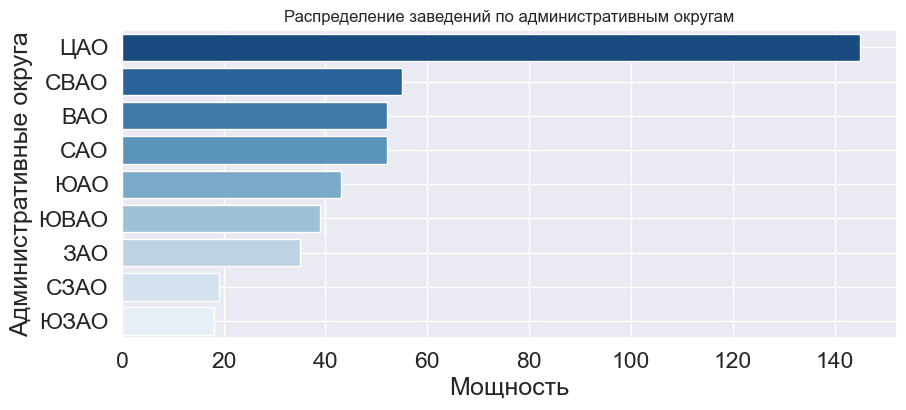

In [66]:
districts_1 = (
    bottom_streets
    .pivot_table(
        index='district', 
        values='address',
        aggfunc='count'
    )
    
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_1 = districts_1.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)

# График распределения заведений по округам
fig, ax = plt.subplots(figsize=(10, 4))
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_1,
    palette='Blues_r'
    
)
sns.set(font_scale=1)
ax.set_title('Распределение заведений по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)

display(districts_1)

In [67]:
moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаю объект m – карту с центром в точке с координатами [moscow_lat, moscow_lng]
m_1 = folium.Map(location=[moscow_lat, moscow_lng])

# Создаю пустой кластер и добавляю его на карту
marker_cluster = MarkerCluster().add_to(m_1)

# Пишу функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяю функцию create_clusters() к каждой строке (axis=1) датафрейма
bottom_streets.apply(create_clusters, axis=1)

m_1

In [68]:
bottom_streets.category.value_counts()

кафе               160
ресторан            93
кофейня             84
бар,паб             39
столовая            36
быстрое питание     23
пиццерия            15
булочная             8
Name: category, dtype: int64

In [69]:
from_1000 = (
    bottom_streets
    .query('middle_avg_bill > 999.0')
    ['name'].count()
)

from_500_to_1000 = (
    bottom_streets
    .query('499.0 <= middle_avg_bill < 1000.0')
    ['name'].count()
)

till_500 = (
    bottom_streets
    .query('500.0 > middle_avg_bill')
    ['name'].count()
)

In [70]:
print('Число заведений с указанным чеком:', 
      bottom_streets.query('middle_avg_bill > 0')['name'].count())

print('Число заведений с чеком от 1000 рублей:', from_1000)

print('Число заведений с чеком от 500 до 1000 рублей:', from_500_to_1000)

print('Число заведений с чеком до 500 рублей:',till_500)


Число заведений с указанным чеком: 165
Число заведений с чеком от 1000 рублей: 61
Число заведений с чеком от 500 до 1000 рублей: 37
Число заведений с чеком до 500 рублей: 67


In [71]:
print('Число сетевых заведений:',
      bottom_streets.query('chain == 1')
      ['name'].count())

print('Число несетевых заведений:',
      bottom_streets.query('chain == 0')
      ['name'].count())


Число сетевых заведений: 133
Число несетевых заведений: 325


In [72]:
count_by_chain_1 = (bottom_streets.
                  pivot_table(index=['chain'],
                              values='address',
                              aggfunc='count')
                  .sort_values(by = 'address', ascending=False)
                 )
count_by_chain_1.columns= ['values']


fig = go.Figure(data=
                [go.Pie(labels=['Несетевые','Сетевые'], 
                        values=count_by_chain_1['values'])]
               )
fig.update_layout(title='Распределение количества заведений по сетевому признаку')  

fig.show() 

# Увы, поменять цвета не удалось. 
# В одной лабе настолько разные коды в разных методах, будто писали их стопицот людей без к.-л. согласования
# Забил и не хочу даже разбираться.

In [73]:
from_1000_all = (
    rest
    .query('middle_avg_bill > 999.0')
    ['name'].count()
)

from_500_to_1000_all = (
    rest
    .query('499.0 <= middle_avg_bill < 1000.0')
    ['name'].count()
)

till_500_all = (
    rest
    .query('500.0 > middle_avg_bill')
    ['name'].count()
)

print('Число заведений с указанным чеком:', 
      rest.query('middle_avg_bill > 0')['name'].count())

print('Число заведений с чеком от 1000 рублей:', from_1000_all)

print('Число заведений с чеком от 500 до 1000 рублей:', from_500_to_1000_all)

print('Число заведений с чеком до 500 рублей:',till_500_all)


Число заведений с указанным чеком: 3148
Число заведений с чеком от 1000 рублей: 1277
Число заведений с чеком от 500 до 1000 рублей: 738
Число заведений с чеком до 500 рублей: 1135


In [74]:
print('Отношение заведений с указанным чеком  ко всем:', 
      round(
          bottom_streets.query('middle_avg_bill > 0')['name'].count() /
          rest.query('middle_avg_bill > 0')['name'].count(), 3))
      
print('Отношение заведений с чеком от 1000 ко всем:', 
      round(from_1000 / from_1000_all, 3))

print('Отношение заведений с чеком от 500 до 1000 ко всем:', 
      round(from_500_to_1000 / from_500_to_1000_all, 3))

print('Отношение заведений с чеком до 500 ко всем:',
      round(till_500 / till_500_all, 3))

Отношение заведений с указанным чеком  ко всем: 0.052
Отношение заведений с чеком от 1000 ко всем: 0.048
Отношение заведений с чеком от 500 до 1000 ко всем: 0.05
Отношение заведений с чеком до 500 ко всем: 0.059


## Анализ улиц с одним заведением общепита
<a id='2.11_total'></a>



Имеем следующее: максимальное размещение в ЦАО - 145 точек. На втором месте СВАО - 55 точек. Далее идёт спуск до 35 точек в районе - ЗАО.

Два наименее представленных района: СЗАО - 19 и	ЮЗАО - 18 точек.


Преобладает всё та же тройка: кафе - 160, рестораны - 93, кофейни - 84.

Меньше всего пиццерий и булочных: 15 и 8. 

Средний чек указан всего в 165 заведениях. Сам чек я разбил на три категории: до 500, от 500 до 1000 и от 1000.

- Число заведений с чеком от 1000 рублей: 61
- Число заведений с чеком от 500 до 1000 рублей: 37
- Число заведений с чеком до 500 рублей: 67


Соотношение сетевых и несетевых 133 (29%) против 325 (71%). Здесь интересно рассуждать: либо почти 1/3, либо почти 1/4. И туда, и сюда 4% :)


Отношение заведений, где указан средний чек: 0.05 от всего числа таких заведений. То же про сами категории среднего чека. И только доля заведений с чеком до 500 рублей составляет 0.06. 


## 2.12 Изучение среднего чека по районам

<a id='2.12'></a>

In [75]:
# Создаю фрейм для карты
avg_bill_for_district = rest.groupby('district', as_index=False)['middle_avg_bill'].agg('median')

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_ab = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и рейтинги, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=avg_bill_for_district,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг среднего чека по районам',
    nbins=9
).add_to(m_ab)

m_ab

In [76]:
bill_dist_all = (
    rest
    .groupby('district', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

bill_dist_ts = (
    top_street
    .groupby('district', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

bill_dist_chain = (
    chain
    .groupby('district', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

bill_dist_chainless = (
    chainless
    .groupby('district', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

# Да тут выше тоже можно было бы функцию, но... 

bills_dist = (bill_dist_all
         .merge(bill_dist_ts,
                how='inner',
                left_on='district',
                right_on='district')
         .merge(bill_dist_chain,
                how='inner',
                left_on='district',
                right_on='district')
         .merge(bill_dist_chainless,
                how='inner',
                left_on='district',
                right_on='district')
         
        )
bills_dist.columns = ['district', 'avg_all', 'avg_top_street', 'avg_chain', 'avg_not_chain']

bills_dist = bills_dist.sort_values(by='avg_all', ascending=False)
bills_dist

,district,avg_all,avg_top_street,avg_chain,avg_not_chain
0,Западный административный округ,1000.0,1100.0,700.0,1000.0
1,Центральный административный округ,1000.0,1000.0,800.0,1200.0
2,Северо-Западный административный округ,700.0,NaN,500.0,925.0
3,Северный административный округ,650.0,900.0,512.5,800.0
4,Юго-Западный административный округ,600.0,650.0,525.0,670.0
5,Восточный административный округ,575.0,NaN,475.0,650.0
6,Северо-Восточный административный округ,500.0,600.0,500.0,500.0
7,Южный административный округ,500.0,512.5,470.0,575.0
8,Юго-Восточный административный округ,450.0,400.0,476.0,412.5


## Анализ среднего чека по районам
<a id='2.12_total'></a>

*Честно говоря, не понял, зачем хороплёт. От него толку никакого*.

1. Влияет ли удалённость от центра (ЦАО) на средний чек, неизвестно. Карта не даёт понять, разбивая чек по районам. Так как нет градиента, то непонятно, как меняется чек по АО. Буду считать, что вопрос имеет в виду не удалённость от центра, а разность районов. В этом случае да, влияние есть. Наивысший средний чек в ЦАО и ЗАО.


2. Второй район с максимальными ценами - Западный админ. округ. Как немосквич, утверждать не возьмусь, но интернет говорит, что в основе ЗАО стоят Дорогомилово, Раменки и Фили-Давыдково, где контингент достаточно состоятельный с доходами от 10 000 долларов. Плюс влияние Рублёвки.
    
    Нужно отметить, что в ЗАО входят и Солнцево, Внуково, которые не особо позитивные, а также Очаково-Матвеевское, где 3/4 территории - промзоны. Однако это не значит, что район не стоит рассматривать, как привлекательный для инвестиций. 
    
    Средний чек в этих районах 1000 рублей. При этом на топовых улицах чек от 1000 и 1100. В несетевых чек от 1200 и 1000, а вот в сетевых ценник значительно ниже - 800 и 700 рублей соответственно.  
    

3. На втором месте Северо-Западный административный округ. 700 рублей общий средний чек, в несетевых 925 рублей, в сетевых 500 рублей. Тоже заметно меньше общего и сетевых. А среди 15 топовых улиц не фигурирует. 


4. Безотносительно расстояния от ЦАО средний чек имеет разные значения по другим округам. Так как все они граничат с ЦАО, нельзя уверенно заявлять о влиянии расстояния. 


Ниже представлена таблица, которая даёт полное представление о ценах и их средних распределениях. 


|Округ                                  |Общий средний|Средний по топ-15 улиц|Средний сетевых|Средний несетвых|
|---------------------------------------|-------------|----------------------|---------------|----------------|
|Центральный административный округ     |	1000.0	  |1000.0	             |800.0          |	1200.0        |
|Западный административный округ        |	1000.0	  |1100.0	             |700.0          |	1000.0        |
|Северо-Западный административный округ |	700.0	  |NaN	                 |500.0          |	925.0         |
|Северный административный округ        |	650.0	  |900.0	             |512.5          |	800.0         |
|Юго-Западный административный округ    |	600.0	  |650.0	             |525.0          |	670.0         |
|Восточный административный округ       |	575.0	  |NaN	                 |475.0          |	650.0         |
|Северо-Восточный административный округ|	500.0	  |600.0	             |500.0          |	500.0         |
|Южный административный округ           |	500.0	  |512.5	             |470.0          |	575.0         |
|Юго-Восточный административный округ   |	450.0	  |400.0	             |476.0          |	412.5         |


Отмечу только, что два района не представлены в списке топа улиц: **СЗАО** и **ВАО**.

В первой четвёрке чек в **несетевых** заведениях заметно выше общего среднего. Там же средний чек в **сетевых** заметно ниже общего среднего. 

В основном чек по топу улиц превышает средний общий по округу. Исключение: **ЮВАО**. В этом же округе средний чек в сетях выше, чем в несетевых.

Выделяются также и **СВАО**, где чек по топу улиц равен 600, а остальные - 500 рублей. То есть отсутствует разница между ними. 

<div class="alert alert-block alert-info"></div>

# Другие связи
<a id='other'></a>

Часть иных связей указана выше: разбивка на сетевые и нет в категориях. Ниже представены средние чеки по категориям заведений с разбивкой на заведения все, по топу улиц, по сетям.  

Собираю четыре фрейма по среднему чеку, чтобы потом объеднить в один.

In [77]:
bill_cat_all = (
    rest
    .groupby('category', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

In [78]:
bill_top_street = (
    top_street
    .groupby('category', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

In [79]:
bill_chain = (
    chain
    .groupby('category', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

In [80]:
bill_chainless = (
    chainless
    .groupby('category', as_index=False)['middle_avg_bill']
    .agg('median')
    .sort_values(by='middle_avg_bill', ascending=False)
)

In [81]:
bills = (bill_cat_all
         .merge(bill_top_street,
                how='inner',
                left_on='category',
                right_on='category')
         .merge(bill_chain,
                how='inner',
                left_on='category',
                right_on='category')
         .merge(bill_chainless,
                how='inner',
                left_on='category',
                right_on='category')
         
        )
bills.columns = ['category', 'avg_all', 'avg_top_street', 'avg_chain', 'avg_not_chain']

bills = bills.sort_values(by='avg_all', ascending=False)
bills

,category,avg_all,avg_top_street,avg_chain,avg_not_chain
0,"бар,паб",1250.0,1250.0,1060.0,1250.0
1,ресторан,1250.0,1150.0,1000.0,1250.0
2,пиццерия,600.0,750.0,500.0,850.0
3,кафе,550.0,600.0,550.0,550.0
4,булочная,450.0,367.5,550.0,425.0
5,кофейня,400.0,400.0,575.0,381.0
6,быстрое питание,375.0,412.5,425.0,350.0
7,столовая,300.0,300.0,300.0,300.0


Исходя из полученного результата, можно сделать вывод, что наивысшие цены в барах и ресторанах. При этом разница в среднем чеке есть только с заведениями на улицах их топа и в сетях - они ниже. В несетевых заведениях цены такие же.


Далее идут пиццерии и кафе, где общий средний ниже, чем средний на улицах из списка топ-15. Сетевые цены ниже или равны, а вот несетевые в пиццериях весьма сильно отличаются. 850 рублей против 600. 


В сетевых булочных, кофейнях и быстропите цены в сетях заметно выше, чем в несетевых. Порой разница достигает 200 рублей. При этом цена общая средняя также ниже, чем в сетях. 


Сети дорогой кухни могут позволить себе более низкие цены за счёт обширной и потому более дешёвой закупки, распределения расходов и иных схем. 


В то же время более высокие цены в сетевых заведениях трёх категорий говорят о том, что здесь, возможно, платят за бренд.

<div class="alert alert-block alert-info"></div>

# 3. Рынок кофеен Москвы
<a id='3'></a>

1. Сколько всего кофеен в датасете? 

2. В каких районах их больше всего, каковы особенности их расположения?

3. Есть ли круглосуточные кофейни?

4. Какие у кофеен рейтинги? 

5. Как они распределяются по районам?

6. На какую стоимость чашки капучино стоит ориентироваться при открытии и почему?

Можно расширить список вопросов для исследования, добавив собственные.

Постройте визуализации. Попробуйте дать рекомендацию для открытия нового заведения. Это творческое задание: здесь нет правильного или неправильного ответа, но ваше решение должно быть чем-то обосновано. Объяснить свою рекомендацию можно текстом с описанием или маркерами на географической карте.

## 3.1 Число кофеен всего, а также по сетевому признаку
<a id='3.1'></a>

In [82]:
# Три сета кофеен:
# все
# сетевые
# несетевые

coffee = rest.query("category == 'кофейня'")
coffee_ch = chain.query("category == 'кофейня'")
coffee_chs = chainless.query("category == 'кофейня'")

In [83]:
print('Всего кофеен:', len(coffee))
chains_total = coffee_ch['name'].nunique()
print('Из них: сетевых - %d точек %d сетей; несетевых - %d' \
      % (len(coffee_ch), chains_total, len(coffee_chs)))

Всего кофеен: 1413
Из них: сетевых - 720 точек 157 сетей; несетевых - 693


In [84]:
count_by_chain_cf = (coffee.
                  pivot_table(index=['chain'],
                              values='address',
                              aggfunc='count')
                  .sort_values(by = 'address', ascending=False)
                 )
count_by_chain_cf.columns= ['values']


fig = go.Figure(data=
                [go.Pie(labels=['Несетевые','Сетевые'], 
                        values=count_by_chain_cf['values'])]
               )
fig.update_layout(title='Распределение количества кофеен по сетевому признаку')  

fig.show()

In [85]:
# Доля от всего объёма заведений

part_cf = round(len(coffee) / len(rest) * 100, 2)

print("Доля кофеен от всего числа заведений: ", part_cf, "%", sep='')

Доля кофеен от всего числа заведений: 16.81%


## Итог
У нас представлены данные о 1413 кофейнях. Это 16.81% от всего числа заведений, о которых есть данные.

Кофейни делятся по сетевому признаку (входит ли в сеть: сетевых - 720 (или 51%), а несетевых - 693 (или 49%).

Разница в долях крайне малозначительна.

## 3.2 Анализ округов
<a id='3.2'></a>

,district,amount,ratio
0,ЦАО,428,30.29
1,САО,193,13.66
2,СВАО,159,11.25
3,ЗАО,150,10.62
4,ЮАО,131,9.27
5,ВАО,105,7.43
6,ЮЗАО,96,6.79
7,ЮВАО,89,6.30
8,СЗАО,62,4.39


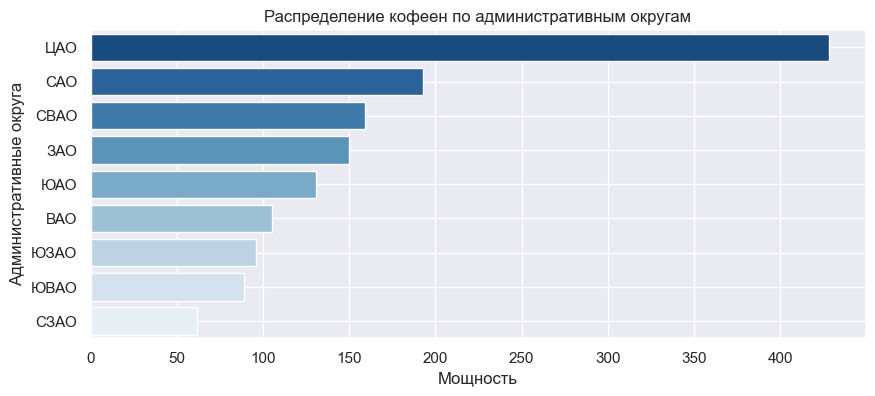

In [86]:
# Изучаю данные по округам

districts_cf = (
    coffee
    .pivot_table(
        index='district', 
        values='address',
        aggfunc='count'
    )
    
    .rename(columns={'address':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_cf = districts_cf.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)

# График распределения заведений по округам
fig, ax = plt.subplots(figsize=(10, 4))
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_cf,
    palette='Blues_r'
    
)
sns.set(font_scale=1)
ax.set_title('Распределение кофеен по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)
districts_cf['ratio'] = round(districts_cf['amount'] / len(coffee) * 100, 2)
display(districts_cf)

In [87]:

moscow_lat, moscow_lng = 55.751244, 37.618423

# Создаю объект m – карту с центром в точке с координатами [moscow_lat, moscow_lng]
map_cf = folium.Map(location=[moscow_lat, moscow_lng])

# Создаю пустой кластер и добавляю его на карту
marker_cluster = MarkerCluster().add_to(map_cf)

# Пишу функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его в кластер marker_cluster
def create_clusters(row):
    Marker(
        [row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}",
    ).add_to(marker_cluster)

# Применяю функцию create_clusters() к каждой строке (axis=1) датафрейма
coffee.apply(create_clusters, axis=1)

map_cf

Наибольшее количество заведений сосредоточено в ЦАО - 428 (30.29%). 

Второе место у САО: 193 точки (13.66%). 

Третье и четвёртое места близки, потому упоминаю оба. 
СВАО - 159 или 11.25% и ЗАО - 150 или 10.62%.

Все остальные имеют менее 10%, а самый некофейный округ - СЗАО. В нём всего 62 заведения и это лишь 4.39%. 

## 3.3 Круглосуточные
<a id='3.3'></a>

In [88]:
all_day = (coffee[coffee['is_24/7'] == True]
           [['name', 'district', 'rating', 'chain', 
             'lat', 'lng', 'middle_coffee_cup']])
print("Число искомых заведений:", len(all_day))
display(all_day.sample(3), list(all_day['name'].unique()))

Число искомых заведений: 59


,name,district,rating,chain,lat,lng,middle_coffee_cup
2353,Кофейня One&Double,Центральный административный округ,4.3,0,55.780087,37.654421,NaN
3358,Пирог Хауз,Западный административный округ,3.8,1,55.727345,37.472614,NaN
3511,Молоко,Центральный административный округ,4.8,0,55.761113,37.614631,NaN


['Wild Bean',
 'Wild Bean Cafe',
 'Шоколадница',
 'Кофе Хауз',
 'Кофемания',
 'You&Coffee',
 'Cinnabon',
 'One Price Coffee',
 'Кофейня One&Double',
 'Cofix',
 'Кофе С Собой',
 'Пирог Хауз',
 'Молоко',
 'Гоголь-Моголь',
 'One And Double',
 'Столица',
 'Лаванда Кофе',
 'Кофе On',
 'One&Double',
 'Foodmoscowcoffee',
 'The Wild Bean Cafe',
 'One More, Please']

In [89]:
print('Доля круглосуточных кофеен от общего числа:  %d; доля круглосуточных кофеен от числа сетевых:  %d' \
      % (round(len(all_day) / len(coffee) * 100, 2), round(len(all_day) / len(coffee_ch) * 100, 2)))
  

Доля круглосуточных кофеен от общего числа:  4; доля круглосуточных кофеен от числа сетевых:  8


,district,amount
0,ЦАО,26
1,ЗАО,9
2,ЮЗАО,7
3,ВАО,5
4,САО,5
5,СВАО,3
6,СЗАО,2
7,ЮВАО,1
8,ЮАО,1


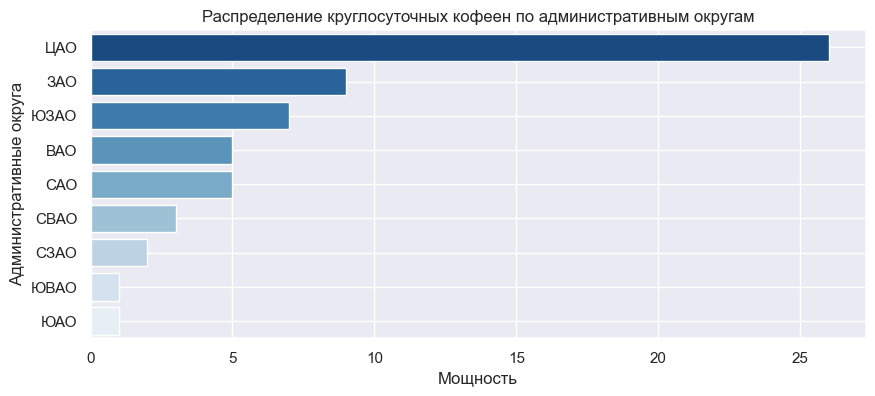

In [90]:
districts_cf_ad = (
    all_day
    .pivot_table(
        index='district', 
        values='name',
        aggfunc='count'
    )
    
    .rename(columns={'name':'amount'})
    .sort_values(by='amount', ascending=False)
    .reset_index()
)

districts_cf_ad = districts_cf_ad.replace(
    {
        'Центральный административный округ':'ЦАО',
        'Северный административный округ':'САО',
        'Южный административный округ':'ЮАО',
        'Северо-Восточный административный округ':'СВАО',
        'Западный административный округ':'ЗАО',
        'Восточный административный округ':'ВАО',
        'Юго-Восточный административный округ':'ЮВАО',
        'Юго-Западный административный округ':'ЮЗАО',
        'Северо-Западный административный округ':'СЗАО'
    }
)

# График распределения заведений по округам
fig, ax = plt.subplots(figsize=(10, 4))
sns.set_style('whitegrid') 
ax = sns.barplot(
    y='district', 
    x='amount', 
    data=districts_cf_ad,
    palette='Blues_r'
    
)
sns.set(font_scale=1)
ax.set_title('Распределение круглосуточных кофеен по административным округам')
ax.set_ylabel('Административные округа')
ax.set_xlabel('Мощность')
plt.grid(True)

display(districts_cf_ad)

In [91]:
# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# подключаем библиотеку
from folium import Marker, Map

# moscow_lat - широта, moscow_lng – долгота
moscow_lat, moscow_lng = 55.751244, 37.618423

# создаём карту Москвы
m_ad = Map(location=[moscow_lat, moscow_lng], zoom_start=10)

# пишем функцию, которая принимает строку датафрейма,
# создаёт маркер в текущей точке и добавляет его на карту
def create_marker(row):
    Marker([row['lat'], row['lng']],
        popup=f"{row['name']} {row['rating']}"
    ).add_to(m_ad)

# применяем функцию для создания маркера к первым 5 записям датафрейма
all_day.apply(create_marker, axis=1)
    
# выводим карту
m_ad

In [92]:
# Рассчитываю рейтинг "ночнушек"

rating_cf_n = (
    all_day
    .pivot_table(
        index = 'district', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
      
)
rating_cf_n.columns = ['mean', 'median']
rating_cf_n = (
    rating_cf_n
    .sort_values(by='mean', ascending=False)
    .reset_index()
)

rating_cf_n

,district,mean,median
0,Восточный административный округ,4.300000,4.20
1,Центральный административный округ,4.288462,4.25
2,Юго-Западный административный округ,4.271429,4.30
3,Северо-Западный административный округ,4.250000,4.25
4,Северный административный округ,4.220000,4.20
5,Западный административный округ,4.200000,4.20
6,Южный административный округ,4.000000,4.00
7,Северо-Восточный административный округ,3.866667,4.00
8,Юго-Восточный административный округ,2.300000,2.30


## Анализ круглосуточных заведений
<a id='3.3_total'></a>

В датасете представлены всего 59 круглосуточных заведений. Все они сетевые. Доля кофеен 24/7 от общего числа заведений: 4%, а от числа сетевых сетевых заведений - 8%. 

Распределены круглосуточные заведения в том же порядке, что и все: лидер с большим отрывом ЦАО - 26 единиц, затем остальные округа. ЗАО - 9, ЮЗАО - 7, ВАО и САО по 5, СВАО - 3, СЗАО - 2, ЮВАО и ЮАО по 1.

Часть располоена на АЗС, несколько у вокзалов. Часть возле неких центров активности, а ещё часть в спальных районах. Причём достаточно неожиданно. 

Рейтинг довольно интересен. Здесь встречаются заведения с низким рейтингом. Так, в ЮВАО **средний** рейтинг 2.3, а СВАО - 3.87. Нудно учесть, что медиана рейтингов в СВАО равна 4 баллам. Разница незначательна на первый взгляд, но с учётом максимального **среднего** рейтинга 4.3 для ВАО, уже заметнее. А чисто психологически вообще влияет сильно. 

Если брать оценки по **медиане**, то первым будет уже ЮЗАО - 4.3. Второе место за ЦАО и СЗАО - 4.25, а ВАО имеет всего 4.2 по медиане, как и САО, ЗАО. 

Это, кстати, интересный вопрос для маркетинга в будущем: какой рейтинг публиковать.

## 3.4 Распределение рейтингов по сетям и районам
<a id='3.4'></a>

In [93]:
# Собираю рейтинги в среднем и медианном значениях
# для всех кофеен
rating_cf = (
    coffee
    .pivot_table(
        index = 'district', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
      
)
rating_cf.columns = ['mean', 'median']
rating_cf = (
    rating_cf
    .sort_values(by='mean', ascending=False)
    .reset_index()
)

rating_cf

,district,mean,median
0,Центральный административный округ,4.336449,4.3
1,Северо-Западный административный округ,4.325806,4.3
2,Северный административный округ,4.291710,4.3
3,Юго-Западный административный округ,4.283333,4.3
4,Восточный административный округ,4.282857,4.3
5,Южный административный округ,4.232824,4.3
6,Юго-Восточный административный округ,4.225843,4.3
7,Северо-Восточный административный округ,4.216981,4.3
8,Западный административный округ,4.195333,4.2


In [94]:
# Карта с рейтингами для всех кофеен

# Создаю фрейм для карты
rating_for_district_cf = coffee.groupby('district', as_index=False)['rating'].agg('mean')

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_cf = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и рейтинги, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=rating_for_district_cf,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Медианный рейтинг заведений по районам',
).add_to(m_cf)

m_cf

In [95]:
# Собираю рейтинг по сетевым
rating_cf_ch = (
    coffee_ch
    .pivot_table(
        index = 'name', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
      
)

rating_cf_ch.columns = ['mean', 'median']
rating_cf_ch = (
    rating_cf_ch
    .sort_values(by='mean', ascending=False)
    .reset_index()
)

# Вывожу на экран первые 5 и последние 5
display(rating_cf_ch.head(5), rating_cf_ch.tail(5))

# Сразу создаю антитоп по низшему рейтингу (менее 4)
bottom_rates_ch = (coffee_ch
                .query('rating < 4.0')
                .sort_values(by='rating', ascending=False)
               )

# Вывожу список "плохих" кофеен
display(bottom_rates_ch.head(3))

# Вывожу число "плохих" кофеен
print('Кофеен с рейтингом ниже 4: %d заведений' % (len(bottom_rates_ch)))
print('Кофеен с рейтингом ниже 4: %d процентов' % (len(bottom_rates_ch) / len(coffee_ch) * 100))


,name,mean,median
0,Маковка,5.000,5.00
1,Барбариста,4.900,4.90
2,Bodrero,4.725,4.75
3,Кондитерская-Кулинария Брусника,4.700,4.70
4,"Может, Кофе?",4.700,4.70


,name,mean,median
152,Coffee Music,3.6,3.6
153,Сказка,3.2,3.2
154,Coffee Party,3.2,3.2
155,French Bakery Sedelice,3.1,3.1
156,Coffprice,3.0,3.0


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
3302,Cinnabon,кофейня,"Москва, Малая Филёвская улица, 22",Западный административный округ,"ежедневно, 10:00–22:00",55.736590,37.465956,3.9,NaN,NaN,NaN,NaN,1,NaN,Малая Филёвская улица,False
1555,Cofix,кофейня,"Москва, Щукинская улица, 42",Северо-Западный административный округ,"ежедневно, 10:00–22:00",55.809742,37.463778,3.9,NaN,Цена чашки капучино:60–120 ₽,NaN,90.0,1,150.0,Щукинская улица,False
3344,Coffee Point,кофейня,"Москва, улица Барклая, 6, стр. 5",Западный административный округ,пн-пт 08:00–19:00,55.739250,37.508229,3.9,NaN,NaN,NaN,NaN,1,41.0,улица Барклая,False


Кофеен с рейтингом ниже 4: 76 заведений
Кофеен с рейтингом ниже 4: 10 процентов


In [96]:
# Создаю фрейм с рейтингами несетевых кофеен
rating_cf_chs = (
    coffee_chs
    .pivot_table(
        index = 'name', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
      
)

rating_cf_chs.columns = ['mean', 'median']
rating_cf_chs = (
    rating_cf_chs
    .sort_values(by='mean', ascending=False)
    .reset_index()
)

# Вывожу по 5 первых и последних записей фрейма
display(rating_cf_chs.head(5), rating_cf_chs.tail(5))

# Создаю антитоп по кофейням с рейтом ниже 4
bottom_rates_chs = (coffee_chs
                .query('rating < 4.0')
                .sort_values(by='rating', ascending=False)
             )

# Вывожу список "плохих" заведений  
display(bottom_rates_chs.head(3))

# Вывожу инфу и числе таких кофеен  
print('Кофеен с рейтингом ниже 4: %d заведений' % (len(bottom_rates_chs)))
print('Кофеен с рейтингом ниже 4: %d процентов' % (len(bottom_rates_chs) / len(coffee_chs) * 100))


,name,mean,median
0,La Vie Café,5.0,5.0
1,Dormouse Coffee Shop,5.0,5.0
2,Big Black Cup Coffee,5.0,5.0
3,За Думой,5.0,5.0
4,Pique-Nique,5.0,5.0


,name,mean,median
670,Brunch Cafe,3.1,3.1
671,Gold,3.0,3.0
672,Шкафе Бульон,2.9,2.9
673,Monty Cafe,2.3,2.3
674,Маракуйя,1.4,1.4


,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
5778,Caffe Galliano,кофейня,"Москва, Матвеевская улица, 2",Западный административный округ,"пн-пт 08:00–21:00; сб,вс 09:00–22:00",55.705187,37.479216,3.9,NaN,Цена чашки капучино:120–210 ₽,NaN,165.0,0,240.0,Матвеевская улица,False
4287,Lav Cafe,кофейня,"Москва, улица Можайский Вал, 8Д",Западный административный округ,пн-пт 08:00–20:00,55.743431,37.555768,3.9,средние,Средний счёт:500–700 ₽,600.0,NaN,0,NaN,улица Можайский Вал,False
6816,Coffee Miru,кофейня,"Москва, улица Мичуринский Проспект, Олимпийская Деревня, 4, корп. 2",Западный административный округ,"ежедневно, 08:30–21:00",55.675574,37.469010,3.9,NaN,NaN,NaN,NaN,0,150.0,улица Мичуринский Проспект,False


Кофеен с рейтингом ниже 4: 62 заведений
Кофеен с рейтингом ниже 4: 8 процентов


## Анализ рейтингов кофеен
<a id='3.4_total'></a>

Средний рейтинг кофеен держится в районе 4.20 - 4.34 балла. Если взять медиану, то ЗАО имеет 4.2, а остальные 4.3 балла. И, если округлять средние чисто математически, то ЮАО, ЮВАО, СВАО должны иметь 4.2, а не 4.3. 
Впрочем, в общем потоке это не существенно.

Поскольку кофейни делятся на сетевые и нет, сделал разбивку. 

1. Сетевые имеют рейтинги от 3 до 5 баллов (средний и медиана). Всего плохих оценок, то есть ниже 4 баллов - 76. Это 10% от числа сетевых кофеен. 

2. Несетевые имеют рейтинги от 1.4 до 5 баллов. Оценок меньше 4 баллов - 62, что составляет 8% от числа несетевых кофеен.

## 3.5 Стоимость чашки кофе
<a id='3.5'></a> 

На какую цену ориентироваться при открытии кофейни. 

In [97]:
price_cup = coffee.query('not middle_coffee_cup.isna()')
display(price_cup.sample(3))
print('Кофеен с известной ценой чашки кофе:', len(price_cup))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
1004,Coffeefox,кофейня,"Москва, Сельскохозяйственная улица, 43, стр. 1",Северо-Восточный административный округ,пн-пт 08:00–19:00; сб 10:00–16:00,55.860863,37.627256,4.6,NaN,Цена чашки капучино:100–179 ₽,NaN,139.0,0,180.0,Сельскохозяйственная улица,False
4734,Лаванда Кофе,кофейня,"Москва, Нижняя Красносельская улица, 35с48",Центральный административный округ,"ежедневно, круглосуточно",55.775128,37.672562,4.3,средние,Цена чашки капучино:189–269 ₽,NaN,229.0,0,NaN,Нижняя Красносельская улица,True
3507,Шоколадница,кофейня,"Москва, улица Красная Пресня, 46с1",Центральный административный округ,"пн-пт 07:30–23:00; сб,вс 08:00–22:00",55.762961,37.564304,4.2,средние,Цена чашки капучино:239–274 ₽,NaN,256.0,1,NaN,улица Красная Пресня,False


Кофеен с известной ценой чашки кофе: 521


In [98]:

price_cup_cf = (
    price_cup
    .pivot_table(
        index = 'name', 
        
        values = 'middle_coffee_cup',
        aggfunc = ['median', 'mean']
    )
      
)

price_cup_cf.columns = ['median', 'mean']
price_cup_cf = (
    price_cup_cf
    .sort_values(by='median', ascending=False)
    .reset_index()
)
display(price_cup_cf.head(10))
display(price_cup_cf.tail(10))
display(price_cup_cf.sample(10))

,name,median,mean
0,Coffee Fm,375.0,375.0
1,Кафетериус,328.0,328.0
2,Диемм,320.0,320.0
3,Il Tocco,315.0,315.0
4,Espressium,300.0,300.0
5,Циники,300.0,300.0
6,Ycp,300.0,300.0
7,Па Па Кофе,300.0,300.0
8,Zest Coffee & Wine,295.0,295.0
9,Дядька Кофе. Картель,290.0,290.0


,name,median,mean
318,One&Double,90.0,90.000000
319,Coffee Guru,89.0,89.000000
320,Country Coffee,84.0,84.000000
321,One Price Coffee,80.0,95.000000
322,Star Hit Cafe,79.0,79.000000
323,Berta,75.0,75.000000
324,I-Cup,75.0,75.000000
325,Cofix,60.0,68.571429
326,Кафе Чудо,60.0,60.000000
327,Cofair,60.0,60.000000


,name,median,mean
226,Coffee Moose,149.0,155.666667
65,B1 Coffee&Goodies,220.0,220.000000
278,Christopher. Co,125.0,125.000000
273,Coffee Music,127.0,127.000000
252,Кофе Твой Друг,135.0,135.000000
296,Кофеграфия,110.0,110.000000
58,Делюсь Душой,225.0,225.000000
54,Krispy Kreme,225.0,224.625000
44,Кофе-Лавка Стол,240.0,240.000000
16,Atelier De Tartelettes,275.0,275.000000


In [99]:
# Двадцать наиболее частых сумм
print('Двадцать наиболее частых сумм:')
display(price_cup_cf['median'].value_counts().head(20))

Двадцать наиболее частых сумм:


150.0    20
170.0    14
200.0    14
165.0    12
135.0    12
180.0    11
225.0    11
250.0    10
160.0    10
125.0    10
155.0     8
100.0     8
275.0     8
120.0     8
140.0     7
175.0     7
130.0     7
139.0     6
210.0     6
195.0     6
Name: median, dtype: int64

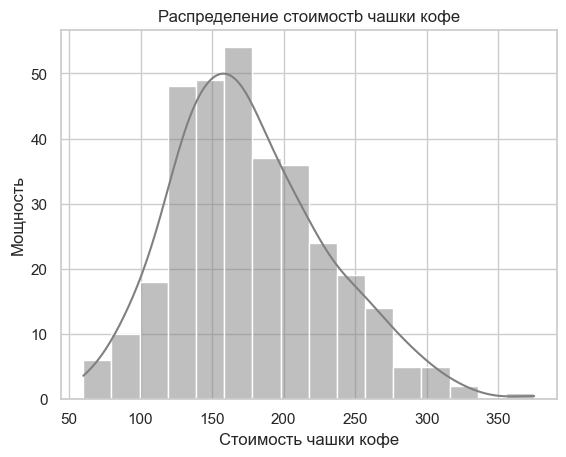

In [100]:
sns.set_style('whitegrid') 
ax = sns.histplot(x='median', data=price_cup_cf, kde=True, color='Grey')

plt.title('Распределение cтоимостb чашки кофе')
plt.xlabel('Стоимость чашки кофе')
plt.ylabel('Мощность')

plt.grid(True)




In [101]:
# Карта с ценами чашки кофе

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_cup = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и цены, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=price_cup,
    columns=['district', 'middle_coffee_cup'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Карта округов по стоимости чашки кофе',
).add_to(m_cup)

m_cup

In [102]:
# Карта со средними ценами чашки кофе

cup_mean = price_cup.groupby('district')['middle_coffee_cup'].agg('mean').reset_index()
cup_mean.columns = ('district', 'mean')

# cup_mean
moscow_lat, moscow_lng = 55.751244, 37.618423
m_cup_mean = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и цены, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=cup_mean,
    columns=['district', 'mean'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Карта округов по стоимости чашки кофе',
).add_to(m_cup_mean)

m_cup_mean

## Анализ стоимости чашки кофе
<a id='3.5_total'></a>

Среднюю стоимость чашки кофе буду брать из медианных. Они лишь в двух случаях отличаются от средних (ниже). 

Максимальная стоимость чашки кофе - 375 рублей. Минимальная - 60 рублей. Вывод случайных значений даёт большой разброс. 

Судя по гистограмме и 20 наиболее частым ценам, оптимальный ценник для чашки кофе в районе 150-200 рублей. С этой ценой можно зайти в ЦАО, ВАО и ЮАО. Однако более подробно в итоговом выводе.

## 3.6 Прочий анализ по кофейням
<a id='3.6'></a>

In [103]:
# Фрейм, где есть данные только о заведениях с известным прайсом
price_cf = coffee.query('not middle_avg_bill.isna()')
display(price_cf.sample(3))
print('Кофеен с известным прайсом: ', len(price_cf))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
4895,Комбинат Дели,кофейня,"Москва, Марксистская улица, 1",Центральный административный округ,"пн-пт 08:00–22:00; сб,вс 10:00–22:00",55.740773,37.658249,4.0,средние,Средний счёт:350–400 ₽,375.0,NaN,0,165.0,Марксистская улица,False
4965,Udcкафе,кофейня,"Москва, Павелецкая площадь, 2с3",Центральный административный округ,"пн-пт 07:00–22:00; сб,вс 10:00–22:00",55.729470,37.636495,4.3,средние,Средний счёт:700–1000 ₽,850.0,NaN,1,NaN,Павелецкая площадь,False
6621,Fresh Cafe,кофейня,"Москва, Ленинский проспект, 119А",Юго-Западный административный округ,пн-пт 09:00–18:00,55.650163,37.488816,4.0,средние,Средний счёт:250 ₽,250.0,NaN,0,NaN,Ленинский проспект,False


Кофеен с известным прайсом:  200


In [104]:
# Карта с ценами для всех кофеен

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_price = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и цены, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=price_cf,
    columns=['district', 'middle_avg_bill'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Карта округов по стоимости чека',
).add_to(m_price)

m_price

In [105]:
# Карта со средними ценами для всех кофеен 
price_mean = price_cf.groupby('district')['middle_avg_bill'].agg('mean').reset_index()
price_mean.columns = ('district', 'mean')


# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_price_mean = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и цены, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=price_mean,
    columns=['district', 'mean'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Карта округов по стоимости чека',
).add_to(m_price_mean)

m_price_mean

In [106]:
# Топ кофеен по условию "больше 10 точек"
top_cf_tmp = (
    coffee
    .pivot_table(
        index='name', # ['category', 'seats', 'avg_bill'],
        values='address', 
        aggfunc='count')
    .sort_values(by='address', ascending=False)
      
)


top_cf_tmp.columns =  ['total_points'] 
top_cf_tmp = top_cf_tmp.query('total_points > 9')
top_cf_query = top_cf_tmp.index
top_cf_points = top_cf_tmp.reset_index()
top_cf_points

,name,total_points
0,Шоколадница,119
1,One Price Coffee,72
2,Cofix,65
3,Кофепорт,42
4,Cofefest,31
5,Кофемания,22
6,Cinnabon,20
7,Правда Кофе,13


In [107]:
top_cf = coffee.query('name in @top_cf_query')
display(top_cf.sample(2))
print('Кофеен из топ-8: %d' % (len(top_cf)))

,name,category,address,district,hours,lat,lng,rating,price,avg_bill,middle_avg_bill,middle_coffee_cup,chain,seats,street,is_24/7
4751,Шоколадница,кофейня,"Москва, Мясницкая улица, 46, стр. 1",Центральный административный округ,"пн-пт 08:00–21:00; сб,вс 10:00–20:00",55.768218,37.644498,4.2,средние,Цена чашки капучино:249–284 ₽,NaN,266.0,1,220.0,Мясницкая улица,False
5993,Шоколадница,кофейня,"Москва, улица Вавилова, 3",Южный административный округ,"ежедневно, 09:00–22:00",55.707817,37.590692,4.3,NaN,NaN,NaN,NaN,1,320.0,улица Вавилова,False


Кофеен из топ-8: 384


In [108]:
print('В топ-8 кофеен по числу точек входят:', list(top_cf_points['name']))

В топ-8 кофеен по числу точек входят: ['Шоколадница', 'One Price Coffee', 'Cofix', 'Кофепорт', 'Cofefest', 'Кофемания', 'Cinnabon', 'Правда Кофе']


In [109]:
# Карта с рейтингами топовых кофеен

# Создаю фрейм для карты
rating_for_district_top_cf = top_cf.groupby('district', as_index=False)['rating'].agg('mean')

# Сохраняю координаты округов в переменную
state_geo = 'https://code.s3.yandex.net/data-analyst/admin_level_geomap.geojson'

# Задаю координаты
moscow_lat, moscow_lng = 55.751244, 37.618423
m_top_cf = folium.Map(location=[moscow_lat, moscow_lng])
# Собственно, сам хороплёт, где гео из заданных ранее границ,
# набор данных, скомпилированный выше, колонки для построения:
# округа и рейтинги, затем строка с ключом и настройки
Choropleth(
    geo_data=state_geo,
    data=rating_for_district_top_cf,
    columns=['district', 'rating'],
    key_on='feature.name',
    fill_color='Blues',
    fill_opacity=0.8,
    legend_name='Средний рейтинг заведений по районам',
).add_to(m_top_cf)

m_top_cf

In [110]:
rating_top_cf = (
    top_cf
    .pivot_table(
        index = 'name', 
        values = 'rating',
        aggfunc = ['mean', 'median']
    )
      
)

rating_top_cf.columns = ['mean', 'median']
rating_top_cf = (
    rating_top_cf
    .sort_values(by='mean', ascending=False)
    .reset_index()
)
rating_top_cf

,name,mean,median
0,Кофемания,4.463636,4.4
1,Правда Кофе,4.261538,4.3
2,Шоколадница,4.178151,4.2
3,Кофепорт,4.147619,4.2
4,Cofix,4.075385,4.1
5,One Price Coffee,4.069444,4.2
6,Cofefest,3.977419,4.0
7,Cinnabon,3.920000,4.2


In [111]:
moda_cf = coffee['rating'].mode() 
moda_top_cf = top_cf['rating'].mode()

print('Наиболее частая оценка для всех кофеен: %f' % (moda_cf))
print('Наиболее частая оценка для топовых кофеен: %f'% (moda_top_cf))

Наиболее частая оценка для всех кофеен: 4.300000
Наиболее частая оценка для топовых кофеен: 4.200000


In [112]:
print('Процент кофеен из топ-8:', round(len(top_cf) / len(coffee) * 100, 2))

Процент кофеен из топ-8: 27.18


## Краткие выводы
<a id='3.6_total'></a>
Итак, у нас всего 8 сетей кофеен, которые имеют больше 9 заведений: Шоколадница, One Price Coffee, Cofix, КОФЕПОРТ, CofeFest, Кофемания, Cinnabon, Правда кофе. 

Самих заведений 382.

**Средний** рейтинг топовых кофеен от 3.92 (Синнабон) до 4.46 (Кофемания). Среди **медианных** значений низшее - 4.00 (Кофест), а высшее 4.40 (Кофемания). При этом тот же Синнабон уже имеет 4.20.

<div class="alert alert-block alert-info">





</div>

# 4. Выводы и рекомендации
<a id='4'></a>

## 4.1 О рынке общественного питания Москвы
<a id='4.1'></a>

На рынке общепита Москвы достаточно широко представлены основные категории заведений - кафе, рестораны и кофейни. Если учитывать факт, что довольно большая часть кафе по своей сути столовые, то сформировать чёткую картину несколько затруднительно. 

**Число топ-3 категорий**:

1. Кафе - 2378: не принадлежат сетям 1599, в сетях 779 (49%)
2. Рестораны - 2043: не принадлежат сетям 1313, в сетях 730 (56%)
3. Кофейни - 1413: не принадлежат сетям 693, в сетях 720 (51%)


**Среднее число посадочных мест в топ-3 категорий**:

1. Рестораны - 86
2. Кофейни - 80
3. Кафе - 60


Если взять **15 наиболее широко представленных сетей**, то среди их категорий будет преобладание кафе, кофеен и ресторанов. 

**По районам категории представлены так**: 

|Округ|1-е место|2-е место|3-е место|Близко к 3-му      |
|-----|---------|---------|---------|-------------------|
|ЦАО  |Ресторан |Кафе     |Кофейня  |Бар/Паб            |
|ЮВАО |Кафе     |Ресторан |Кофейня  |Быстропит          |
|ВАО  |Кафе     |Ресторан |Кофейня  |Бар/Паб, пиццерия  |
|СВАО |Кафе     |Ресторан |Кофейня  |Нет                |
|ЮАО  |Кафе     |Ресторан |Кофейня  |Нет                |
|ЗАО  |Кафе     |Ресторан |Кофейня  |Нет                |
|ЮЗАО |Кафе     |Ресторан |Кофейня  |Пиццерия, быстропит|
|САО  |Кафе     |Кофейня  |Ресторан |Нет                |
|СЗАО |Кафе     |Ресторан |Кофейня  |Пицца              |

Можно сказать, что кофеен пока меньшинство. 


**Рейтинги**: 

Лидируют бары/пабы с рейтингом 4.39. Далее идут пиццерии и рестораны с разницей в одну десятую балла - 4.30 и 4.29.

Рейтинг кофеен 4.28 (4-е место), а кафе - 4.12 (7-е место). 

У кафе рейтинг выше в сетевых заведениях - на 11 сотых, а в кофейнях и ресторанах рейтинг выше у несетевых - 15 сотых и 10 сотых соответственно.

Наивысший рейтинг заведений в ЦАО.

**О географии**:

- Наибольшее число заведений находится на проспекте Мира - 184. Тройка лидеров заведений - кафе, рестораны и кофейни.

- Второе место занимает улица Профсоюзная, где 122 заведения. Тройка лидеров заведений - кафе, рестораны и кофейни.

- Третье место у проспекта Вернадского со 108 заведениями. Тройка лидеров заведений - рестораны, кафе и кофейни.

Есть и такие улицы, где всего одно заведение. Их много, но я беру всё ту же тройку категорий:

- Кафе - 160
- Ресторан - 93
- Кофейня - 84


**Средний чек по округам**:

|Округ                                  |Общий средний|Средний по топ-15 улиц|Средний сетевых|Средний несетвых|
|---------------------------------------|-------------|----------------------|---------------|----------------|
|Центральный административный округ     |	1000.0	  |1000.0	             |800.0          |	1200.0        |
|Западный административный округ        |	1000.0	  |1100.0	             |700.0          |	1000.0        |
|Северо-Западный административный округ |	700.0	  |NaN	                 |500.0          |	925.0         |
|Северный административный округ        |	650.0	  |900.0	             |512.5          |	800.0         |
|Юго-Западный административный округ    |	600.0	  |650.0	             |525.0          |	670.0         |
|Восточный административный округ       |	575.0	  |NaN	                 |475.0          |	650.0         |
|Северо-Восточный административный округ|	500.0	  |600.0	             |500.0          |	500.0         |
|Южный административный округ           |	500.0	  |512.5	             |470.0          |	575.0         |
|Юго-Восточный административный округ   |	450.0	  |400.0	             |476.0          |	412.5         |


**Средний чек по категориям**:

|Категория      |Общий средний|Средний по топ-15 улиц|Средний сетевых|Средний несетвых|
|---------------|-------------|----------------------|---------------|----------------|
|бар,паб	    |1250.0	      |1250.0	             |	1060.0	     |1250.0          |
|ресторан	    |1250.0	      |1150.0	             |1000.0	     |	1250.0        |
|пиццерия	    |600.0	      |750.0	             |500.0		     |850.0           |
|кафе	        |550.0	      |	600.0	             |550.0		     |550.0           |
|булочная       |450.0	      |	367.5	             |550.0		     |425.0           |
|кофейня	    |400.0	      |	400.0	             |575.0		     |381.0           |
|быстрое питание|375.0	      |	412.5	             |425.0		     |350.0           |
|столовая	    |300.0	      |	300.0	             |300.0		     |300.0           |


Как мы видим, в ресторанах чек разнится между сетевыми и несетевыми, в последних чек выше. В кафе чек не разнится, а в кофейнях наборот в сетях чек выше. Весьма значительно. Но в целом он близок к среднему. 

## 4.2 Портрет кофеен Москвы
<a id='4.2'></a>

Всего кофеен: 1413. Это 16.81% от всего числа заведений, о которых есть данные.

Из них: **сетевых** - 720 точек 159 сетей (51%); **несетевых** - 693 (49%)

**География**:

Наибольшее количество заведений сосредоточено в ЦАО - 428 (30.29%).

Второе место у САО: 193 точки (13.66%).

Третье и четвёртое места близки, потому упоминаю оба. СВАО - 159 или 11.25% и ЗАО - 150 или 10.62%.

Все остальные имеют менее 10%, а самый некофейный округ - СЗАО. В нём всего 62 заведения и это лишь 4.39%.

**Круглосуточные**:

- доля круглосуточных кофеен от общего числа:  4%; 
- доля круглосуточных кофеен от числа сетевых:  8%. 

Все круглосуточные кофейни - сетевые. 

Распределены круглосуточные заведения в том же порядке, что и все: лидер с большим отрывом ЦАО - 26 единиц, затем остальные округа. ЗАО - 9, ЮЗАО - 7, ВАО и САО по 5, СВАО - 3, СЗАО - 2, ЮВАО и ЮАО по 1.

Часть располоена на АЗС, несколько у вокзалов. Часть возле неких центров активности, а ещё часть в спальных районах. Причём достаточно неожиданно.

Рейтинг довольно интересен. Здесь встречаются заведения с низким рейтингом. Так, в ЮВАО средний рейтинг 2.3, а СВАО - 3.87. Нудно учесть, что медиана рейтингов в СВАО равна 4 баллам. Разница незначательна на первый взгляд, но с учётом максимального среднего рейтинга 4.3 для ВАО, уже заметнее. А чисто психологически вообще влияет сильно.

Если брать оценки по медиане, то первым будет уже ЮЗАО - 4.3. Второе место за ЦАО и СЗАО - 4.25, а ВАО имеет всего 4.2 по медиане, как и САО, ЗАО.


**Рейтинги**:

Средний рейтинг кофеен держится в районе 4.20 - 4.34 балла. Если взять медиану, то ЗАО имеет 4.2, а остальные 4.3 балла. И, если округлять средние чисто математически, то ЮАО, ЮВАО, СВАО должны иметь 4.2, а не 4.3. 
Впрочем, в общем потоке это не существенно.

Поскольку кофейни делятся на сетевые и нет, сделал разбивку. 

1. Сетевые имеют рейтинги от 3 до 5 баллов (средний и медиана). Всего плохих оценок, то есть ниже 4 баллов - 76. Это 10% от числа сетевых кофеен. 

2. Несетевые имеют рейтинги от 1.4 до 5 баллов. Оценок меньше 4 баллов - 62, что составляет 8% от числа несетевых кофеен.


**Цена чашки кофе**:

Максимальная стоимость чашки кофе - 375 рублей. Минимальная - 60 рублей. Вывод случайных значений даёт большой разброс.

Судя по гистограмме и 20 наиболее частым ценам, оптимальный ценник для чашки кофе в районе 150-200 рублей. С этой ценой можно зайти в ЦАО, ВАО и ЮАО. 


**Средний чек**:

Поскольку в кофейнях не только пьют чашку кофе, изучил общий прайс. Самые высокие цены в СВАО и СЗАО. Самые низкие и ЮАО и ЗАО. Как ни удивительно, в ЦАО общий прайс ближе к минимальному. Возможно, дело в том, что в ЦАО больше указаны цены за чашку капучино. 

**Сетевые**: этих кофеен достаточно много, но только 8 сетей имеют больше 10 заведений. При этом тройка лидеров выглядит так: 

1. Шоколадница - 119
2. One Price Coffee - 71
3. Cofix - 65

Далее идут КОФЕПОРТ, CofeFest, Кофемания, Cinnabon, Правда кофе, а их числа от 42 постепенно опускаются до 12. 

Самих заведений на этот топ - 382. Это 27% от всего числа кофеен. И это значительная часть.

Средний рейтинг топовых кофеен от 3.92 (Синнабон) до 4.46 (Кофемания). Среди медианных значений низшее - 4.00 (Кофест), а высшее 4.40 (Кофемания). При этом тот же Синнабон уже имеет 4.20.


**Наиболее частые оценки**:

- для всех кофеен: 4.3
- для топ-8 кофеен: 4.2


<hr>



## 4.3 Рекомендации

<a id='4.3'></a>

Исходя из анализа имеющихся данных, сложно сделать какой-либо вывод. 

**У нас нет информации**:

- о проходимости мест (как много людей идёт мимо);
- о заполняемости заведений (насколько плотно заполнено в разное время);
- о посещаемости (как часто посещают);
- о методе расчёта среднего чека (из основного меню, из обеденного меню);
- об арендной плате;
- о площадях.

Вполне возможно, что кофейня на 50 посадочных мест со средним чеком в 400 рублей убыточна просто потому, что никто не посещает её. 

Как сказал один ревьюер: "Ну, предположим, что это вот прям хорошие данные". Ок. Будем считать так :) 

<hr>

Исходя из анализа могу сказать, что кофейня - не лучшее вложение. Лучше вложить деньги в кафе.

1. Средний чек выше на треть. Однако разница в числе посадочных мест (на четверть) может нивелировать сей плюс. Отсюда идёт во-вторых. 

2. Кофейни достаточно часто посещаются одинокими людьми. В том числе просто поработать у розетки. В кафе обычно больше посетителей за одним столом, а работников в принципе меньше.

3. Самих кафе больше, а это говорит о популярности формата. Рынок устоялся уже давно, и вряд ли кофейня его взорвёт.

4. Кафе даёт возможность снять его на праздник. В то же время кофейня вряд ли этим похвастается. 

5. Кафе даёт возможность привлекать людей бранчами и прочим отдельным меню. В том числе веганским. Кофейня - нет.

6. Кафе может проводить акции типа "Недели такой-то кухни". Кофейня - нет.

Рекомендую рассмотреть именно вариант круглосуточного кафе. В том числе анти-кафе, коим по сути является Central Perk. Кухня смешанная. Районы те же, что для кофейни ниже.


<hr>

Исходя из требований, рекомендую рассмотреть район для размещения ВАО (низкий средний чек) или ЗАО (чек высокий, но места притяжения), или окраины ЦАО.

Средний чек на 5-10% ниже среднего по округу. 

Чашку кофе на 5% ниже средней по району, но не ниже, чем 20% от максимальной цены по району.

Система налогообложения: УСН (15% или 6% стоит рассчитать).

Заведение круглосуточное. 

[top](#top)